# Candidates

My class definitions in `data['class']`:
- Red: Likely candidate
- Orange: Not sure
- Yellow: Not sure, but likely not from visual inspection.
- Purple: Not a candidate
- Green: Interesting, but not what I am looking for.

In [1]:
import os
os.chdir('../scripts')
from analysis_tools_cython import *
from matplotlib.colors import BoundaryNorm, LogNorm
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import pickle

In [2]:
plt.rcParams['figure.figsize'] = (20,10)

## Import data

#### Candidate Data

In [3]:
data = pd.read_csv('../candidates/candidates-full.csv')
data = data[data.skewness < 8]

In [4]:
tic = pd.read_csv('../tic_catalog.txt',sep='\t')

#### Beta Pic Search Results

In [9]:
with open('betapic_results.pkl', 'rb') as file:
    bpic = pickle.load(file)

---

### TIC Catalog Cross Ref

In [5]:
data['bp-rp'] = data['gaiabp'] - data['gaiarp']
data['M'] = data['GAIAmag'] - (5 * (np.log10(data['d'])) ) + 5
tic['bp-rp'] = tic['gaiabp'] - tic['gaiarp']
tic['M'] = tic['GAIAmag'] - (5 * (np.log10(tic['d'])) ) + 5

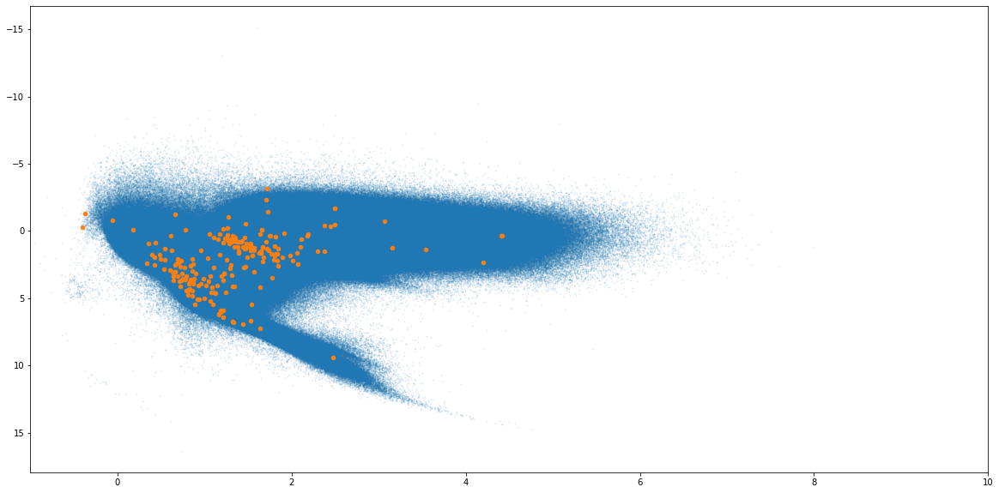

In [6]:
plt.scatter(tic['bp-rp'],tic.M,s=1,alpha=0.1)
plt.scatter(data[(data['class'] == 'red') | (data['class'] == 'orange') ]['bp-rp'], data[(data['class'] == 'red') | (data['class'] == 'orange')]['M'], s=20)
plt.gca().invert_yaxis()
plt.xlim([-1,10])
plt.show()

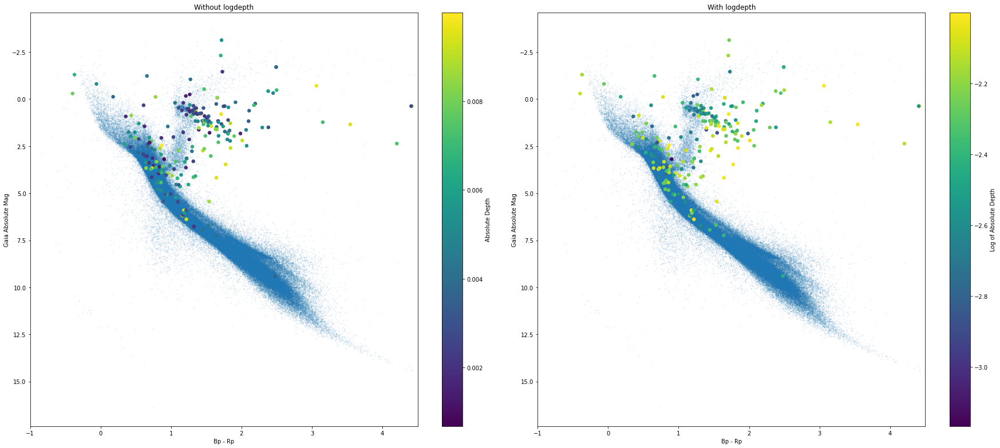

In [7]:
fig, axs = plt.subplots(1, 2, figsize=(25, 11))

scatter1 = axs[0].scatter(tic[tic.d < 150]['bp-rp'], tic[tic.d < 150].M, s=1, alpha=0.1)
scatter2 = axs[0].scatter(data[(data['class'] == 'red') | (data['class'] == 'orange')]['bp-rp'],
               data[(data['class'] == 'red') | (data['class'] == 'orange')]['M'], s=30, c=data[(data['class'] == 'red') | (data['class'] == 'orange')]['abs_depth'],zorder=3)
axs[0].set_ylabel('Gaia Absolute Mag')
axs[0].set_xlabel('Bp - Rp')
axs[0].invert_yaxis()
axs[0].set_xlim([-1, 4.5])
axs[0].set_title('Without logdepth')

cbar1 = plt.colorbar(scatter2, ax=axs[0])
cbar1.set_label('Absolute Depth')


logdepth = np.log10(data[(data['class'] == 'red') | (data['class'] == 'orange')].abs_depth)
scatter3 = axs[1].scatter(tic[tic.d < 150]['bp-rp'], tic[tic.d < 150].M, s=1, alpha=0.1)
scatter4 = axs[1].scatter(data[(data['class'] == 'red') | (data['class'] == 'orange')]['bp-rp'],
               data[(data['class'] == 'red') | (data['class'] == 'orange')]['M'], s=30, c=logdepth,zorder=3)
axs[1].set_ylabel('Gaia Absolute Mag')
axs[1].set_xlabel('Bp - Rp')
axs[1].invert_yaxis()
axs[1].set_xlim([-1, 4.5])
axs[1].set_title('With logdepth')

cbar2 = plt.colorbar(scatter4, ax=axs[1])
cbar2.set_label('Log of Absolute Depth')

plt.tight_layout()
plt.savefig('../hr-diagram-targets.png',dpi=300, bbox_inches='tight')
plt.show()

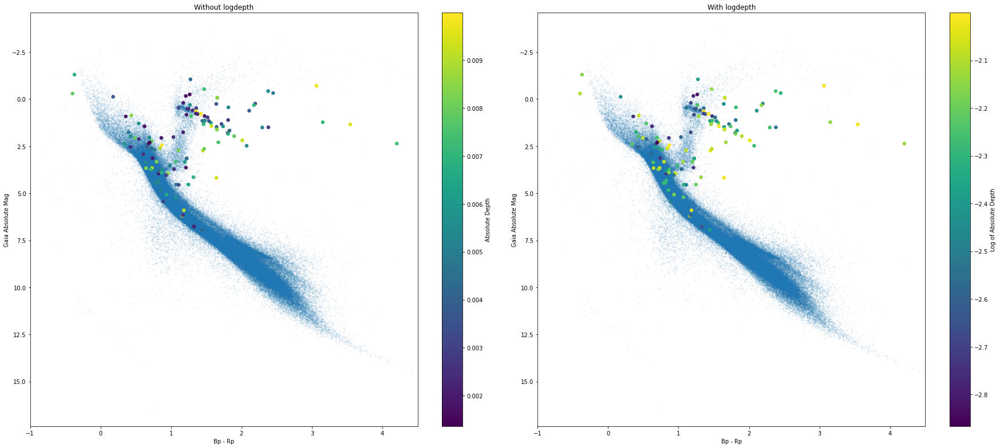

In [8]:
fig, axs = plt.subplots(1, 2, figsize=(25, 11))

scatter1 = axs[0].scatter(tic[tic.d < 150]['bp-rp'], tic[tic.d < 150].M, s=1, alpha=0.1)
scatter2 = axs[0].scatter(data[(data['class'] == 'red')]['bp-rp'],
               data[(data['class'] == 'red')]['M'], s=30, c=data[(data['class'] == 'red')]['abs_depth'],zorder=3)
axs[0].set_ylabel('Gaia Absolute Mag')
axs[0].set_xlabel('Bp - Rp')
axs[0].invert_yaxis()
axs[0].set_xlim([-1, 4.5])
axs[0].set_title('Without logdepth')

cbar1 = plt.colorbar(scatter2, ax=axs[0])
cbar1.set_label('Absolute Depth')


logdepth = np.log10(data[(data['class'] == 'red')].abs_depth)
scatter3 = axs[1].scatter(tic[tic.d < 150]['bp-rp'], tic[tic.d < 150].M, s=1, alpha=0.1)
scatter4 = axs[1].scatter(data[(data['class'] == 'red')]['bp-rp'],
               data[(data['class'] == 'red')]['M'], s=30, c=logdepth,zorder=3)
axs[1].set_ylabel('Gaia Absolute Mag')
axs[1].set_xlabel('Bp - Rp')
axs[1].invert_yaxis()
axs[1].set_xlim([-1, 4.5])
axs[1].set_title('With logdepth')

cbar2 = plt.colorbar(scatter4, ax=axs[1])
cbar2.set_label('Log of Absolute Depth')

plt.tight_layout()
plt.savefig('../hr-diagram-targets.png',dpi=300, bbox_inches='tight')
plt.show()

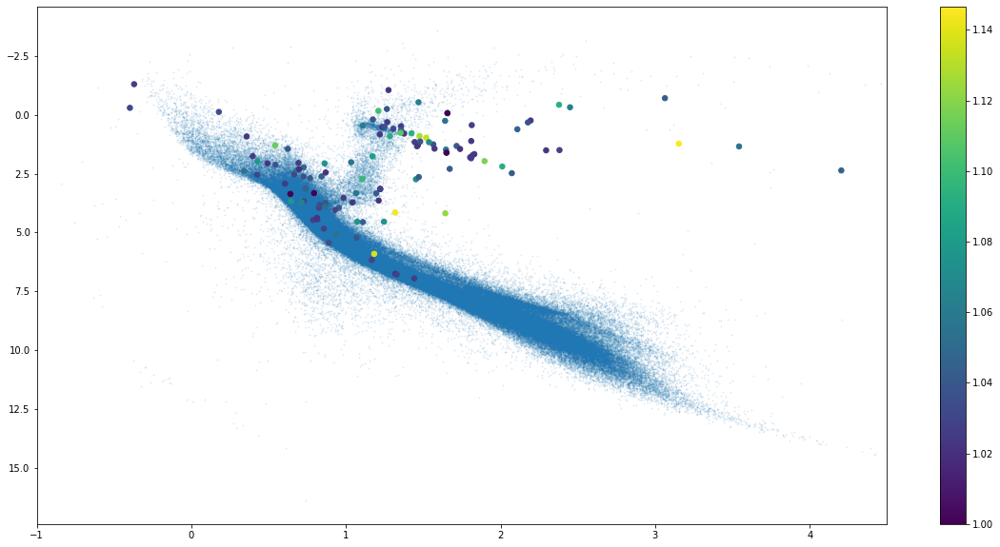

In [9]:
plt.scatter(tic[tic.d < 150]['bp-rp'],tic[tic.d < 150].M,s=1,alpha=0.1)
plt.scatter(data[((data['class'] == 'red')) & (data.asym_score < 1.2) ]['bp-rp'], data[((data['class'] == 'red') )& (data.asym_score < 1.2)]['M'], s=30,c=data[((data['class'] == 'red') )& (data.asym_score < 1.2)].asym_score)
plt.colorbar()
plt.gca().invert_yaxis()
plt.xlim([-1,4.5])
plt.savefig('../hr-diagram-asym.png',dpi=300)
plt.show()

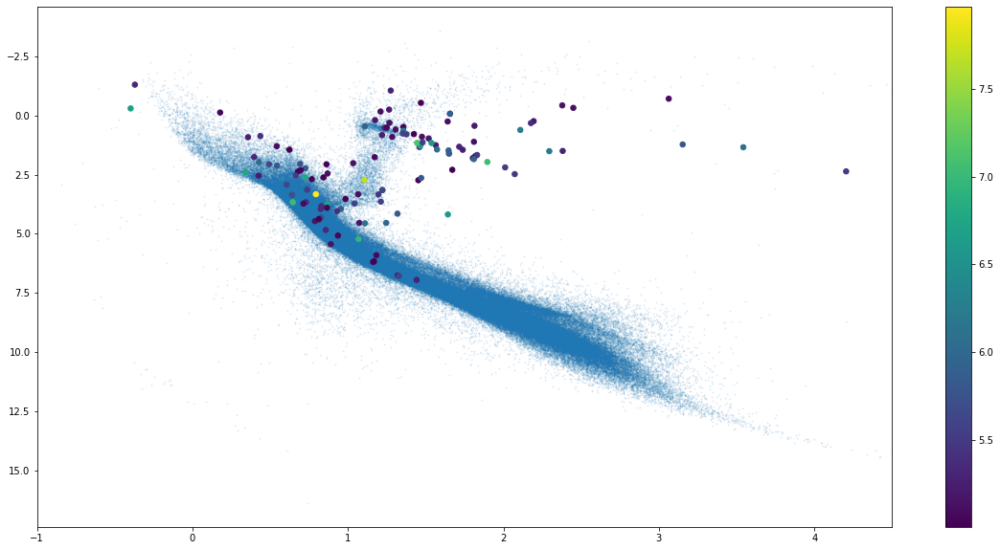

In [10]:
plt.scatter(tic[tic.d < 150]['bp-rp'],tic[tic.d < 150].M,s=1,alpha=0.1)
plt.scatter(data[(data['class'] == 'red')]['bp-rp'], data[(data['class'] == 'red')]['M'], s=30,c=abs(data[(data['class'] == 'red')].snr))
plt.colorbar()
plt.gca().invert_yaxis()
plt.xlim([-1,4.5])
plt.savefig('../hr-diagram-snr.png',dpi=300)

plt.show()

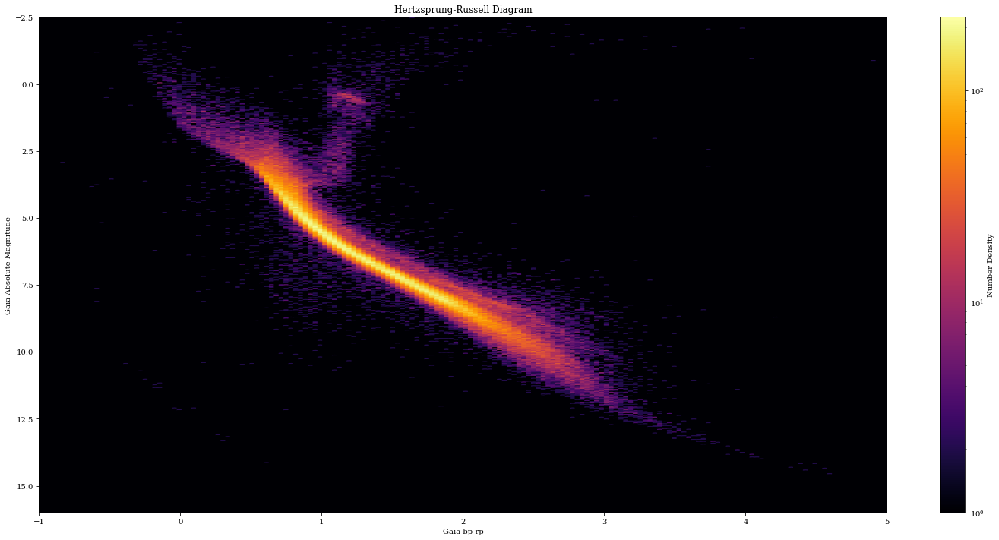

In [11]:
plt.figure(figsize=(25, 12))
plt.rc('font', family='serif')
plt.gca().set_facecolor('white')
plt.hexbin(tic[tic.d < 150]['bp-rp'], tic[tic.d < 150]['M'], gridsize=1000, cmap='inferno', bins='log')
plt.colorbar(label='Number Density')
plt.xlabel('Gaia bp-rp')
plt.ylabel('Gaia Absolute Magnitude')
plt.xlim([-1,5])
plt.ylim([-2.5,16])
plt.title('Hertzsprung-Russell Diagram')
plt.gca().invert_yaxis()
#plt.scatter(data[data['class'] == 'red']['bp-rp'], data[data['class'] == 'red']['M'], c=data[data['class'] == 'red']['depth'], cmap='viridis', marker='o', s=50, edgecolors='black', linewidths=0.5)
plt.savefig('../hr-diagram.png',dpi=300, bbox_inches='tight')
plt.show()

In [12]:
import seaborn as sns

Voila.

---

#### Bp - Rp

In [13]:
data = data[data.asym_score > 1.02]

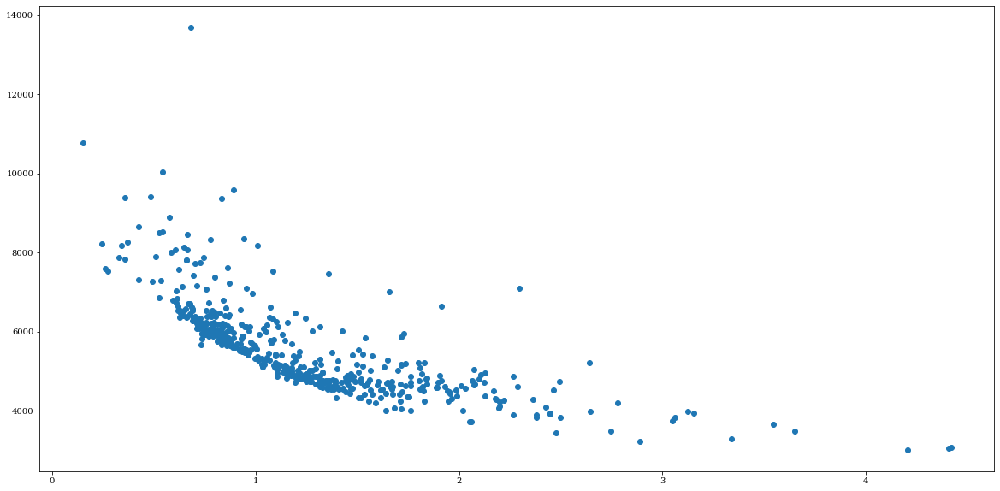

In [14]:
plt.scatter(data['bp-rp'],data['Teff'])
plt.savefig('../teff-bprp.png',dpi=300)

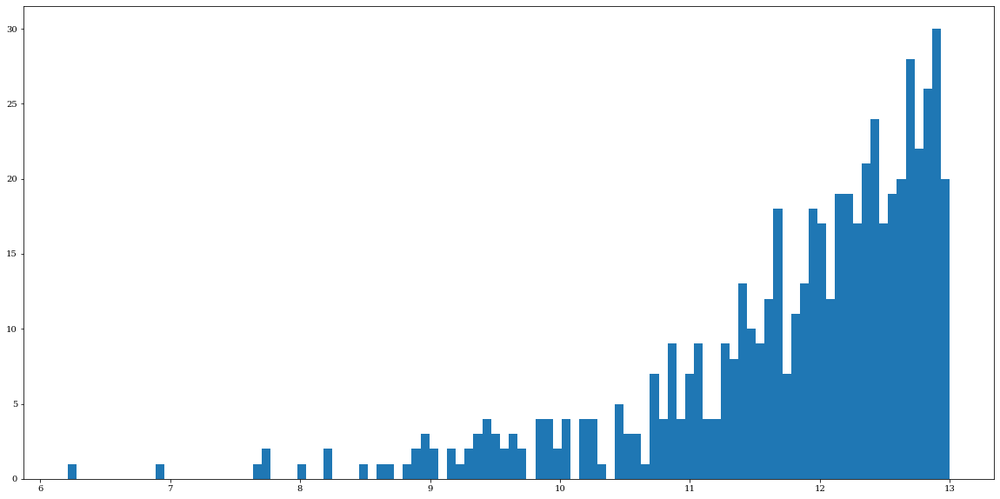

In [15]:
_, _, _  = plt.hist(data['Tmag'],bins=100)

In [16]:
data.lumclass

1       DWARF
2       DWARF
4       DWARF
5       GIANT
7       DWARF
        ...  
3477    DWARF
3484    DWARF
3489    DWARF
3495    DWARF
3523    DWARF
Name: lumclass, Length: 563, dtype: object

In [17]:
corr_mat = data.corr()

In [18]:
import seaborn as sns

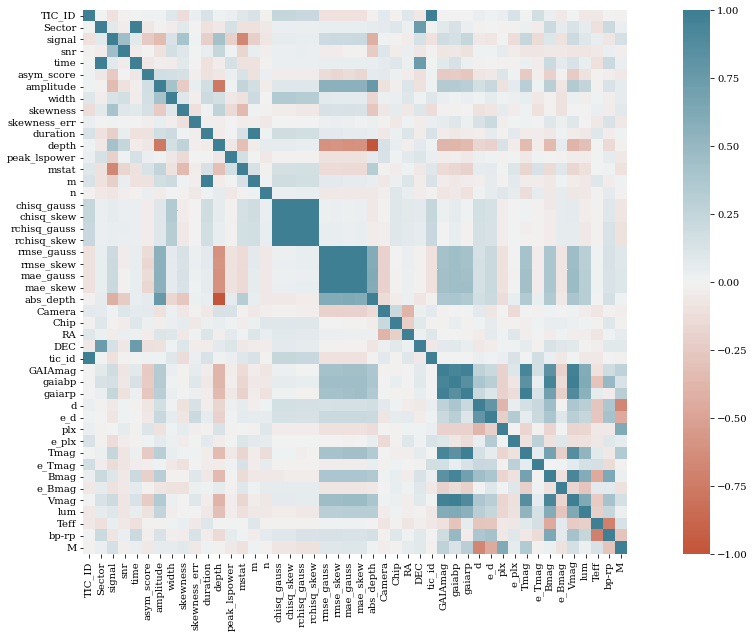

In [19]:
ax = sns.heatmap(
    corr_mat, 
    vmin=-1, vmax=1, center=0,
    cmap=sns.diverging_palette(20, 220, n=200),
    square=True
)
plt.savefig('../corr-mat.png',dpi=300, bbox_inches='tight')

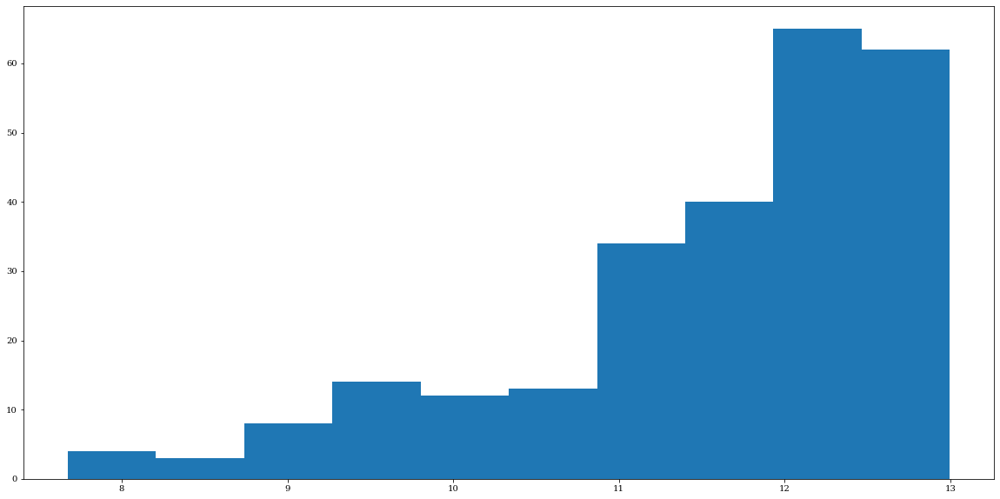

In [20]:
plt.hist(data[data['lumclass'] == 'GIANT'].Tmag)
plt.show()

In [21]:
data.lumclass.unique()

array(['DWARF', 'GIANT', nan], dtype=object)

In [22]:
len(data[data.lumclass == 'GIANT'])

255

(-1.0, 4.5)

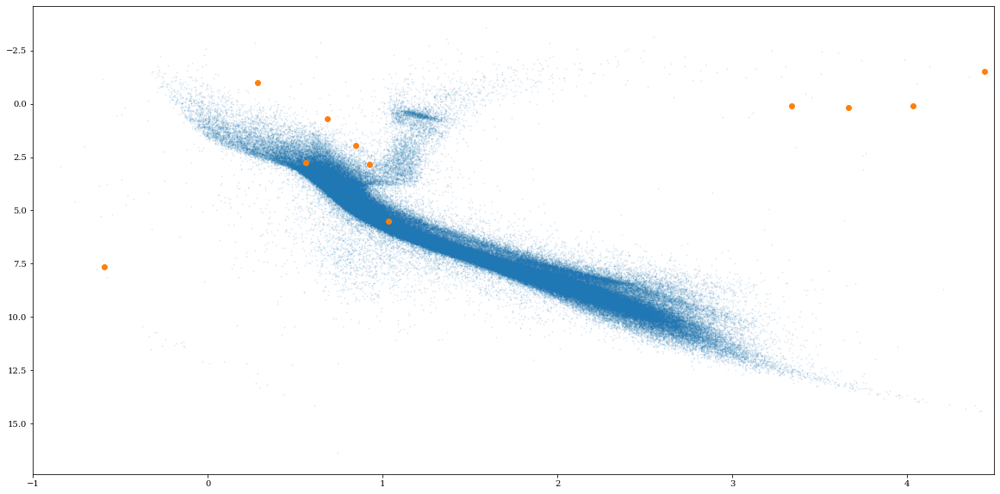

In [23]:
nan = data[~((data.lumclass == 'GIANT') | (data.lumclass == 'DWARF'))]
plt.scatter(tic[tic.d < 150]['bp-rp'],tic[tic.d < 150].M,s=1,alpha=0.1)
plt.scatter(nan[nan['class'] == 'purple']['bp-rp'],nan[nan['class'] == 'purple']['M'])
plt.gca().invert_yaxis()
plt.xlim([-1,4.5])

In [24]:
dwarf = data[(data['lumclass'] == 'DWARF') & (data['class'] == 'red')]
giant = data[(data['lumclass'] == 'GIANT') & (data['class'] == 'red')]

---

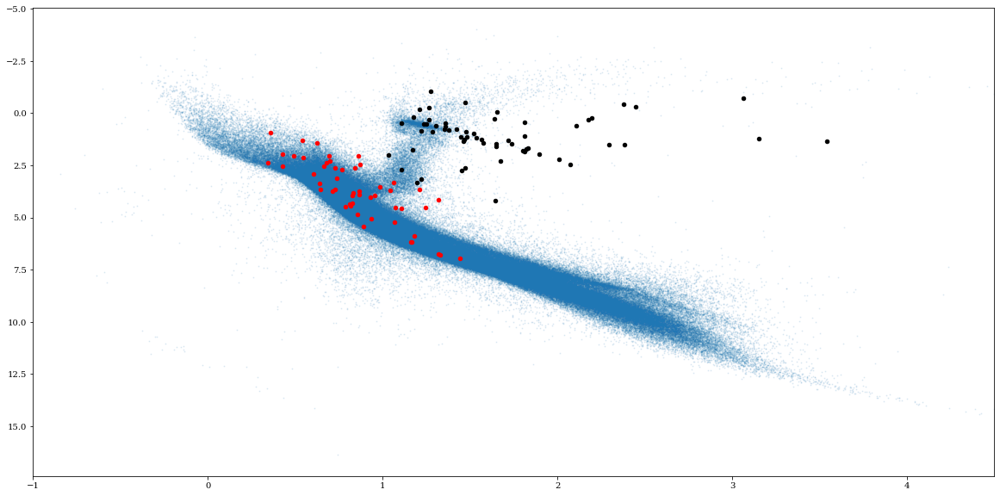

In [34]:
plt.scatter(tic[tic.d < 200]['bp-rp'],tic[tic.d < 200].M,s=1,alpha=0.1)
plt.scatter(dwarf['bp-rp'], dwarf['M'], s=20,c='red')
plt.scatter(giant['bp-rp'], giant['M'], s=20,c='black')

plt.gca().invert_yaxis()
plt.xlim([-1,4.5])
plt.show()

#### Distrbution of transit depths

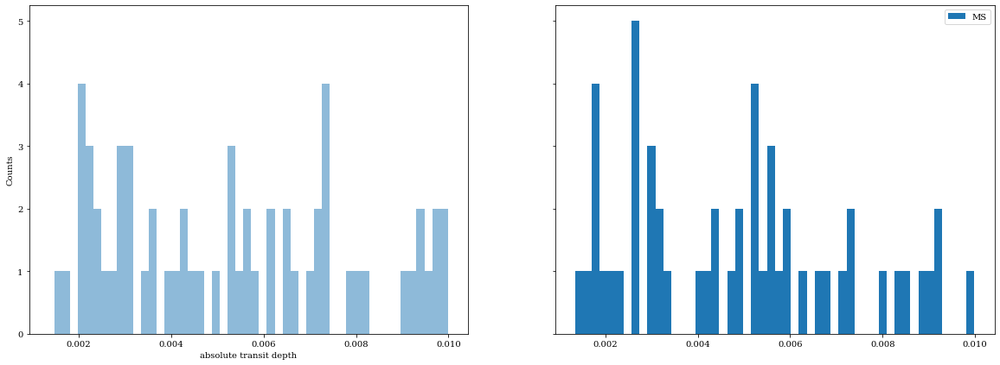

In [26]:
hist, ax_hist = plt.subplots(1,2,figsize=(20,7),sharey=True,sharex=True)
ax_hist[0].hist(giant.abs_depth,bins=50,zorder=3,label='giants',alpha=0.5)
ax_hist[1].hist(dwarf.abs_depth,bins=50,label='MS')
ax_hist[0].set_xlabel('absolute transit depth')
ax_hist[0].set_ylabel('Counts')
plt.savefig('../transit-depth.png',dpi=300)
plt.legend()
plt.show()

#### Distribution of asymmetry

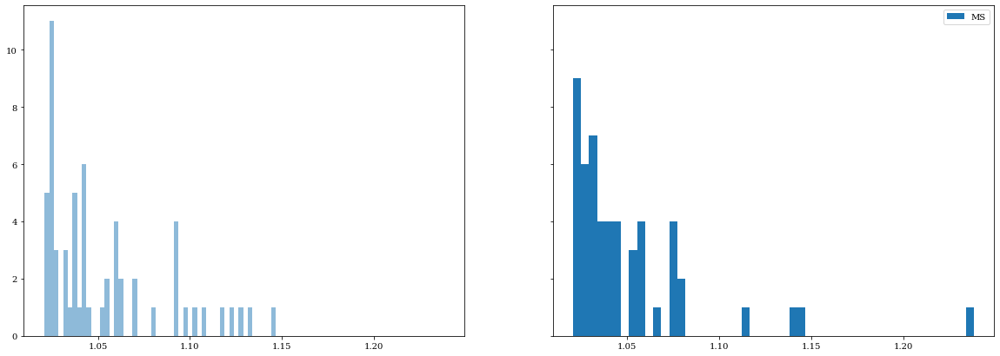

In [27]:
hist, ax_hist = plt.subplots(1,2,figsize=(20,7),sharey=True,sharex=True)
ax_hist[0].hist(giant.asym_score,bins=50,zorder=3,label='giants',alpha=0.5)
ax_hist[1].hist(dwarf.asym_score,bins=50,label='MS')
#ax_hist[0].set_xlabel('absolute transit depth')
#ax_hist[0].set_ylabel('Counts')
plt.savefig('../asym-score-dist.png',dpi=300)
plt.legend()
plt.show()

In [28]:
len(data)

563

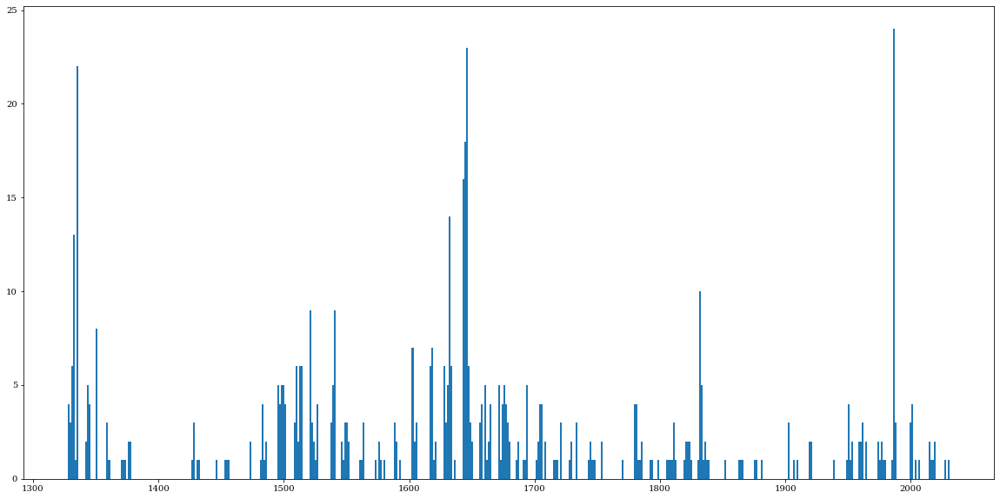

In [29]:
counts, bins, _ = plt.hist(data.time,bins=500)
plt.savefig('../hist-commontimes.png',dpi=300)

In [30]:
max_bin_index = np.argmax(counts)
max_bin = bins[max_bin_index]

In [31]:
bins[max_bin_index + 1]

1987.6760566

In [32]:
test = data[(data.time > max_bin) & (data.time < bins[max_bin_index+1])]

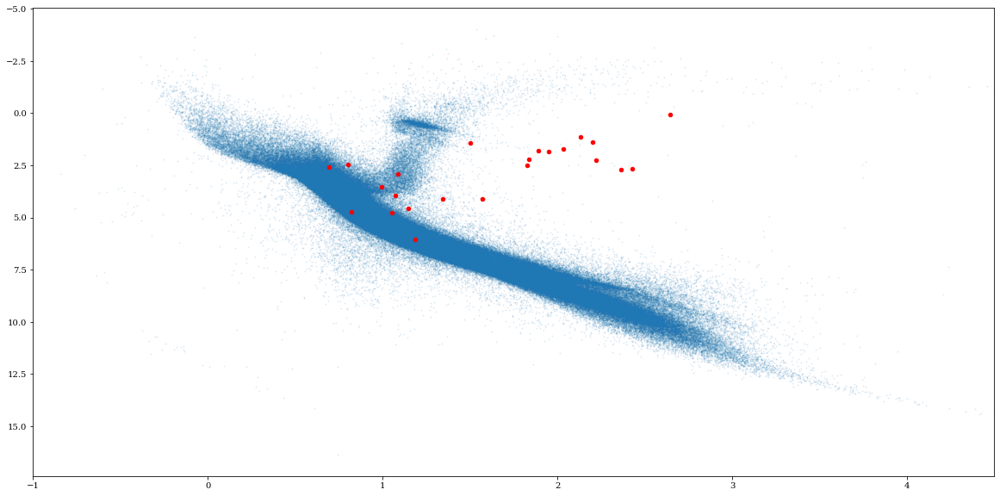

In [33]:
plt.scatter(tic[tic.d < 200]['bp-rp'],tic[tic.d < 200].M,s=1,alpha=0.1)
plt.scatter(test['bp-rp'], test['M'], s=20,c='red')

plt.gca().invert_yaxis()
plt.xlim([-1,4.5])
plt.show()

In [46]:
data = data[~(data['class'] == 'purple')]

In [ ]:
plt.scatter(tic[tic.d < 200]['bp-rp'], tic[tic.d < 200].M, s=2, alpha=0.1, color='gray',label='Stars in sample')
plt.scatter(data['bp-rp'], data['M'], s=20)

logdepth = np.log10(data.abs_depth)
plt.scatter(data['bp-rp'],
            data['M'], s=30, c=logdepth, zorder=3)

plt.ylabel('Gaia Absolute Mag')
plt.xlabel('Bp - Rp')
plt.gca().invert_yaxis()
plt.xlim([-1, 4.5])
plt.title('HR Diagram of Candidates')

# Adding legend for clarity
plt.legend()

# Adding colorbar based on scatter plot (scatter4 was not defined in your provided code)
cbar = plt.colorbar(label='Log Depth')

plt.xlim([-1, 4.5])
plt.savefig('../hr-diagram.png',bbox_inches='tight',dpi=300)
plt.show()

In [34]:
for i in test.abs_path:
    print(i)
    #lc, lc_info = import_lightcurve(i)
    #lc = lc['TIME','PCA_FLUX','QUALITY','FLUX_ERR','FLUX_BKG','X_CENTROID','Y_CENTROID','CORR_FLUX']
    #_, _ = processing(lc,lc_info=lc_info,method='median',make_plots=True)

/storage/astro2/phrdhx/eleanor-lite-project-v2/s0012/hlsp_gsfc-eleanor-lite_tess_ffi_s0012-0000000046165046_tess_v1.0_lc.fits
/storage/astro2/phrdhx/eleanor-lite-project-v2/s0012/hlsp_gsfc-eleanor-lite_tess_ffi_s0012-0000000349196570_tess_v1.0_lc.fits
/storage/astro2/phrdhx/eleanor-lite-project-v2/s0012/hlsp_gsfc-eleanor-lite_tess_ffi_s0012-0000000150727675_tess_v1.0_lc.fits
/storage/astro2/phrdhx/eleanor-lite-project-v2/s0012/hlsp_gsfc-eleanor-lite_tess_ffi_s0012-0000000044204680_tess_v1.0_lc.fits
/storage/astro2/phrdhx/eleanor-lite-project-v2/s0012/hlsp_gsfc-eleanor-lite_tess_ffi_s0012-0000000351627364_tess_v1.0_lc.fits
/storage/astro2/phrdhx/eleanor-lite-project-v2/s0012/hlsp_gsfc-eleanor-lite_tess_ffi_s0012-0000000044615937_tess_v1.0_lc.fits
/storage/astro2/phrdhx/eleanor-lite-project-v2/s0012/hlsp_gsfc-eleanor-lite_tess_ffi_s0012-0000000046274964_tess_v1.0_lc.fits
/storage/astro2/phrdhx/eleanor-lite-project-v2/s0012/hlsp_gsfc-eleanor-lite_tess_ffi_s0012-0000000349304357_tess_v1.0_

---
## Compare with QLP

In [35]:
from astroquery.mast import Observations
import lightkurve as lk

In [36]:
tics = test.TIC_ID.values
sector = test.Sector.values

46165046


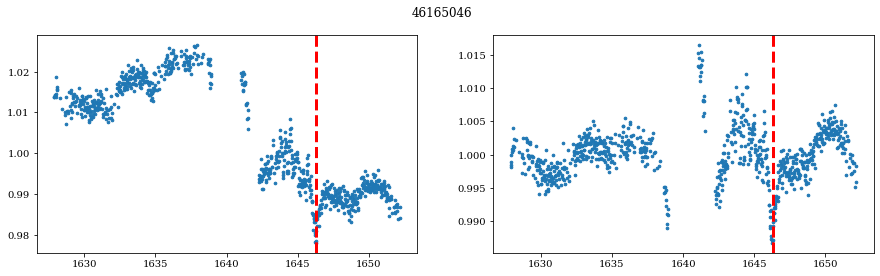

349196570


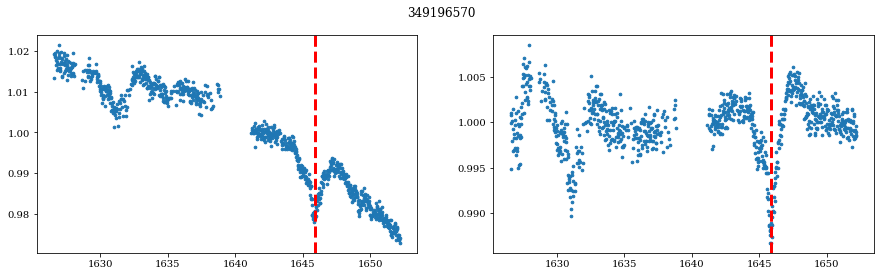

150727675


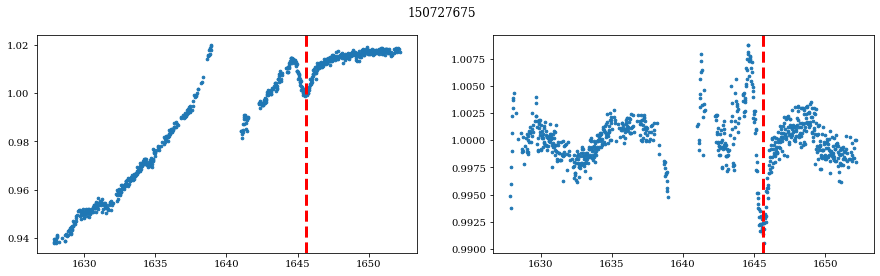

44204680


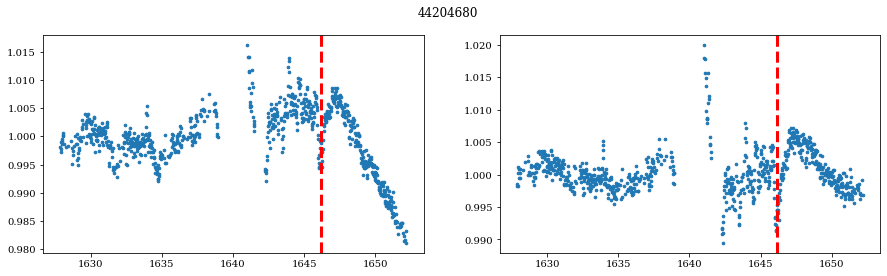

351627364


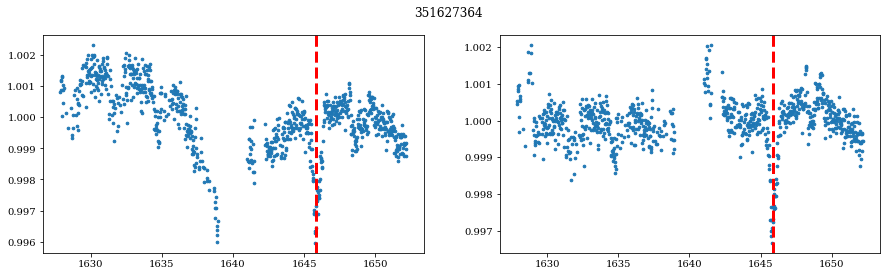

In [37]:
for i in test.abs_path.head(): #4 x 4 grid for illustration purposes
    #print(len(data_new[(data_new.asym_score >=0.9) & (data_new.asym_score <= 1) & (abs(data_new.depth) >= 0.1)]))
    lc, lc_info = import_lightcurve(i)
    lc = lc['TIME','PCA_FLUX','QUALITY','FLUX_ERR','FLUX_BKG','X_CENTROID','Y_CENTROID','CORR_FLUX','RAW_FLUX']
    fig, ax = plt.subplots(1,2,figsize=(15,4))
    print(lc_info[0])
    ax[0].scatter(lc['TIME'],lc['RAW_FLUX']/np.median(lc['RAW_FLUX']),s=7)
    ax[0].axvline(data[data.TIC_ID == lc_info[0]].time.values[0],linestyle='--',linewidth=3,color='red')
    ax[1].scatter(lc['TIME'],lc['PCA_FLUX']/np.median(lc['PCA_FLUX']),s=7)
    ax[1].axvline(data[data.TIC_ID == lc_info[0]].time.values[0],linestyle='--',linewidth=3,color='red')
    #_, _ = processing(lc,lc_info=lc_info,method='median',make_plots=True)
    fig.suptitle(f"{lc_info[0]}")
    plt.show()
    

### Drop the common times again

In [38]:
data = data[~data.isin(test.to_dict(orient='list')).all(axis=1)].reset_index(drop=True)

406277263


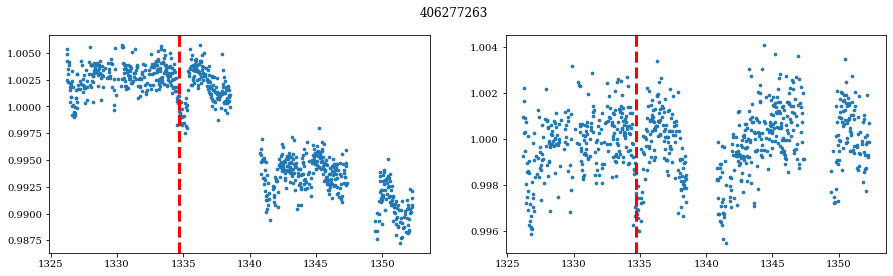

382187660


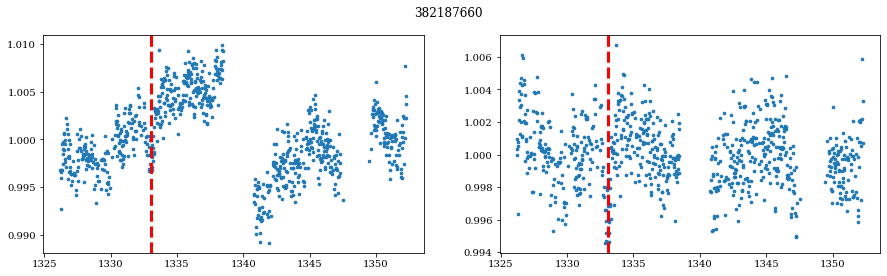

389660859


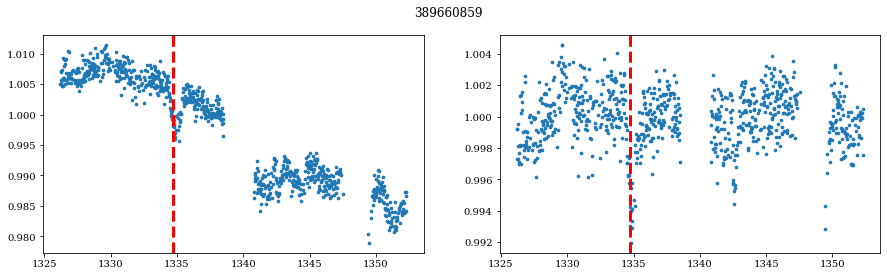

469912242


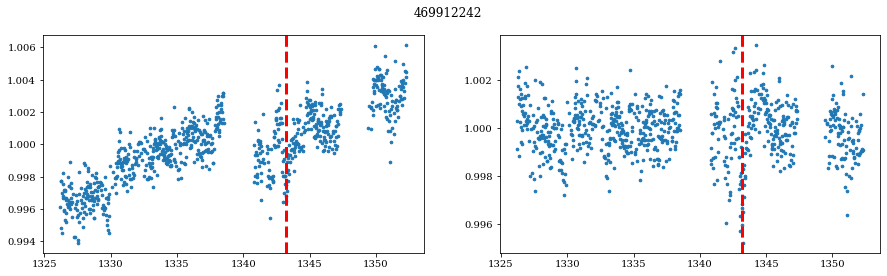

350843855


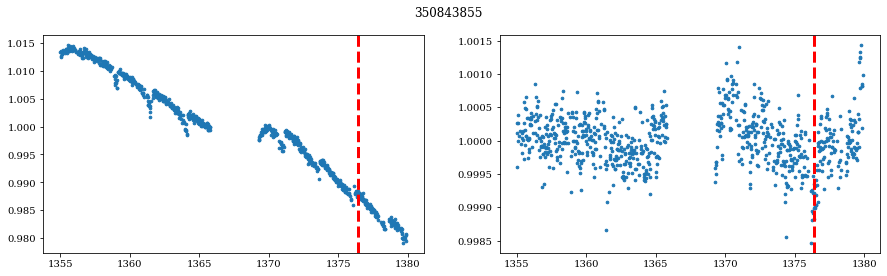

55525572


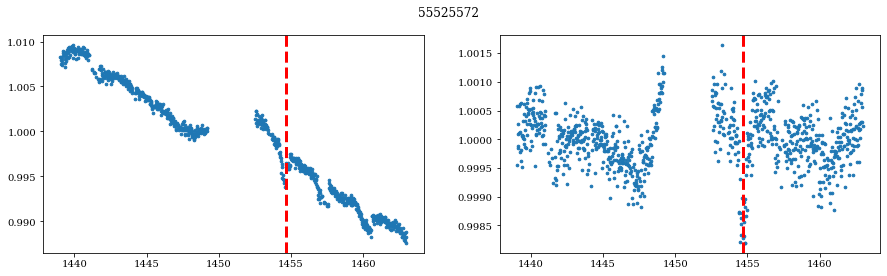

37485564


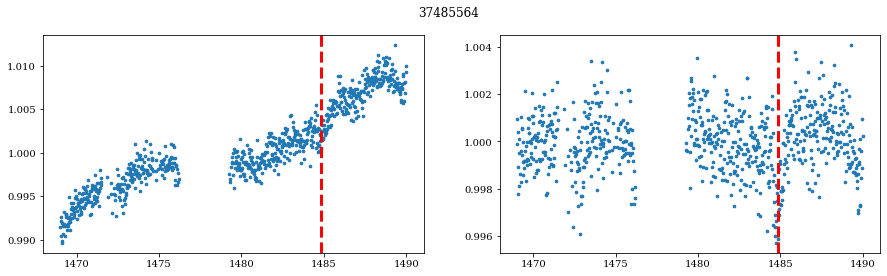

373914067


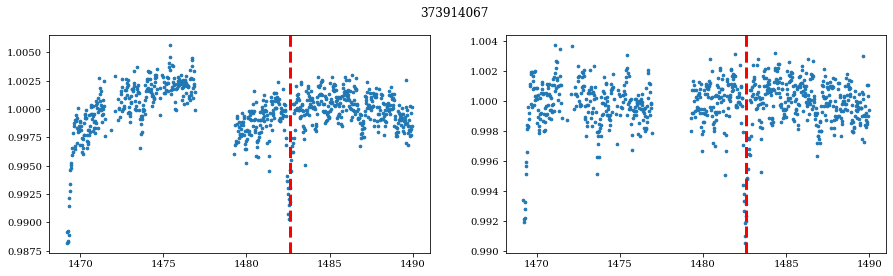

382572476


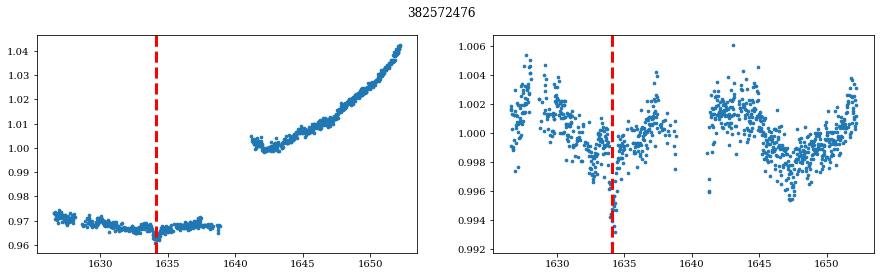

131422529


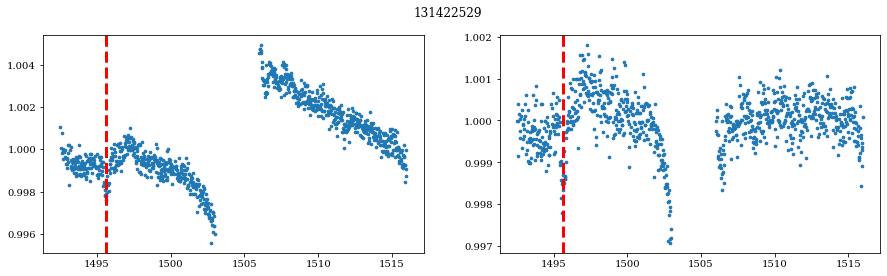

146626827


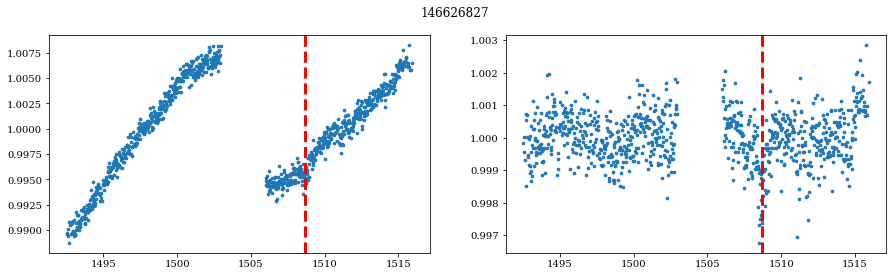

80551703


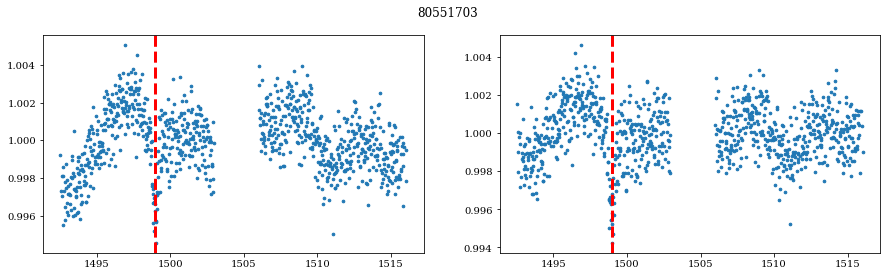

143152957


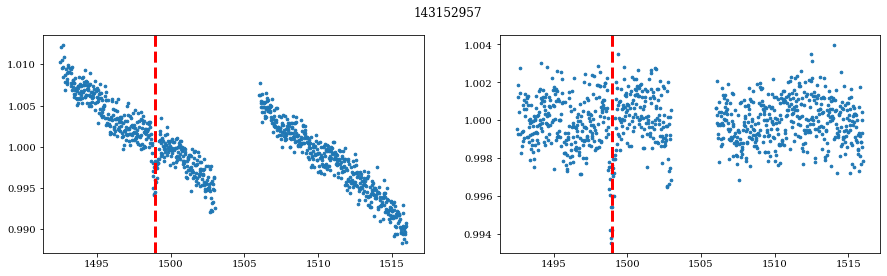

373913825


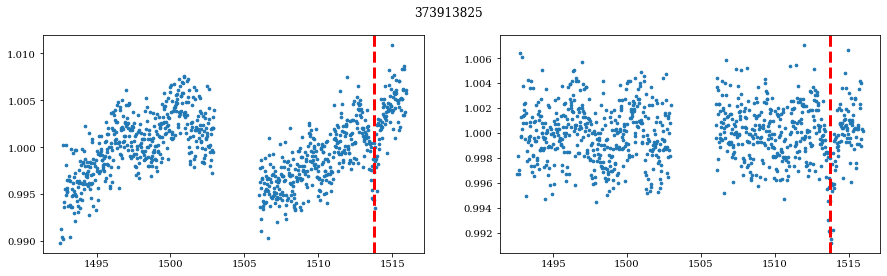

340004858


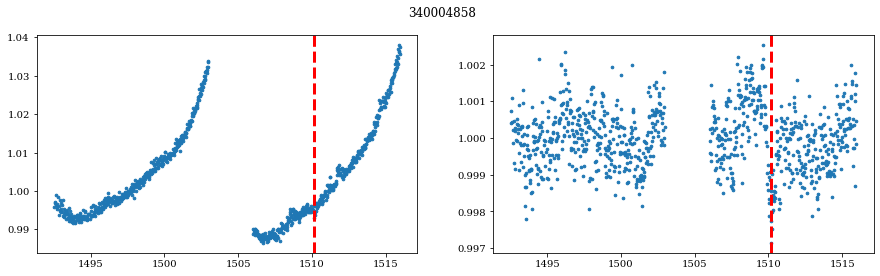

110969638


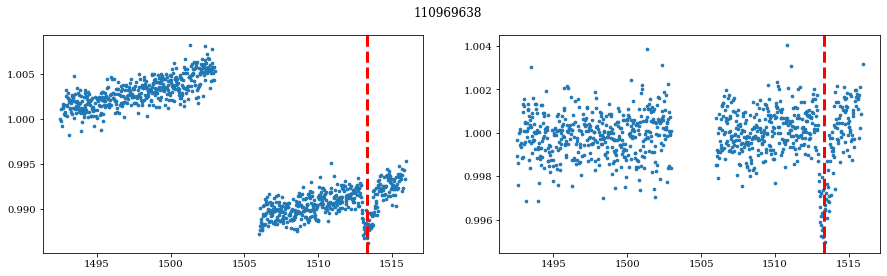

64953602


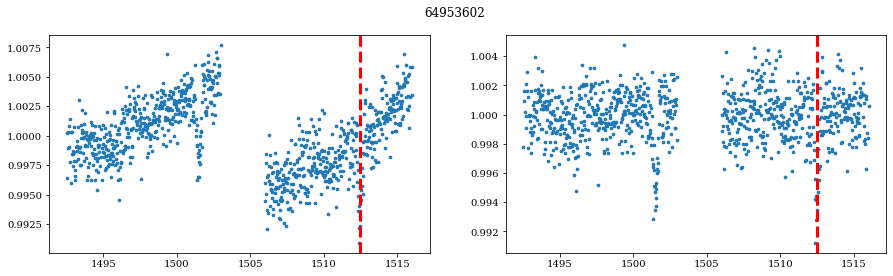

350843056


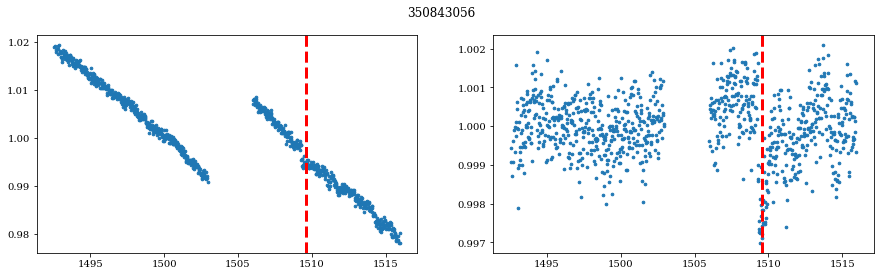

419365265


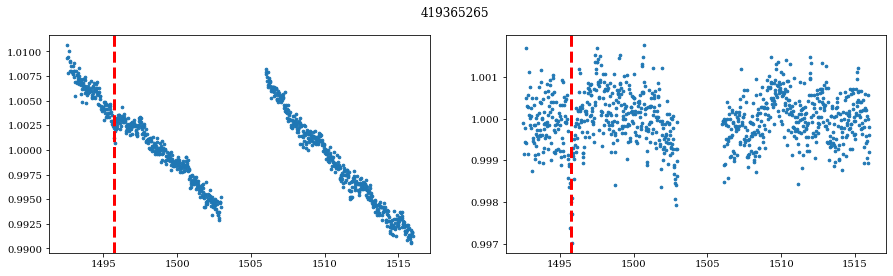

145276049


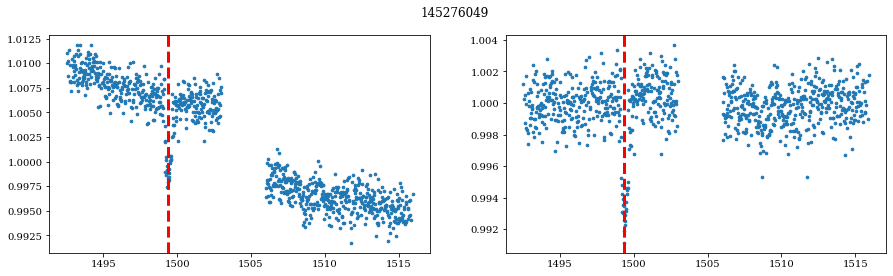

110610421


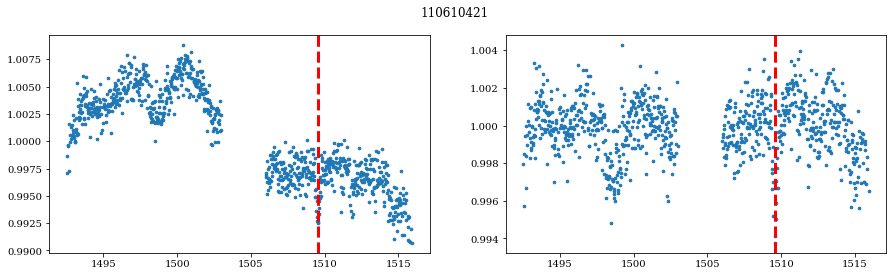

134743129


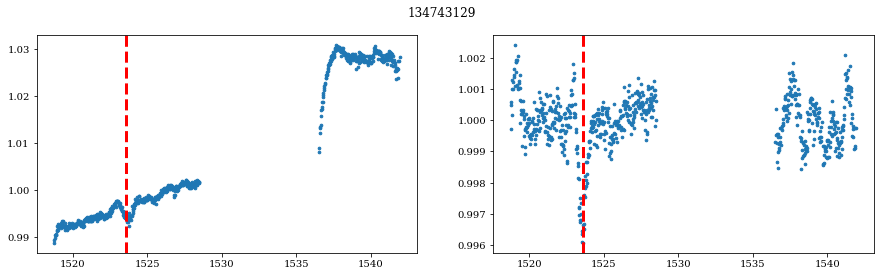

355773606


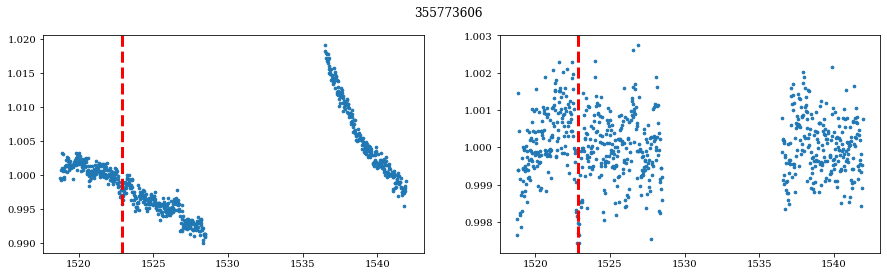

186056754


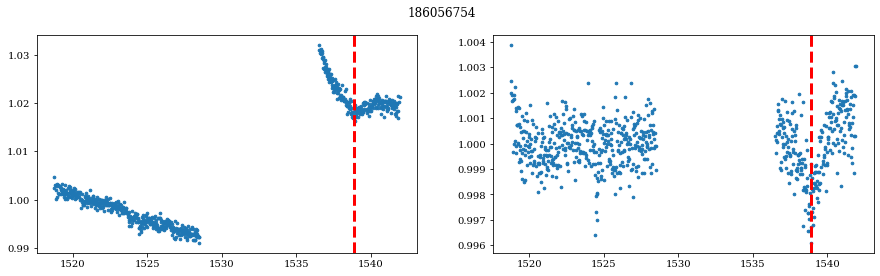

383186717


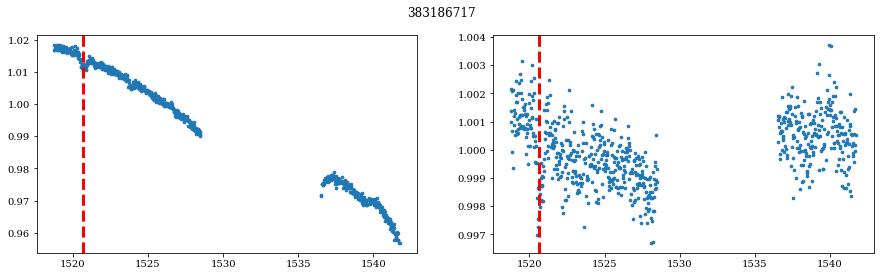

114485654


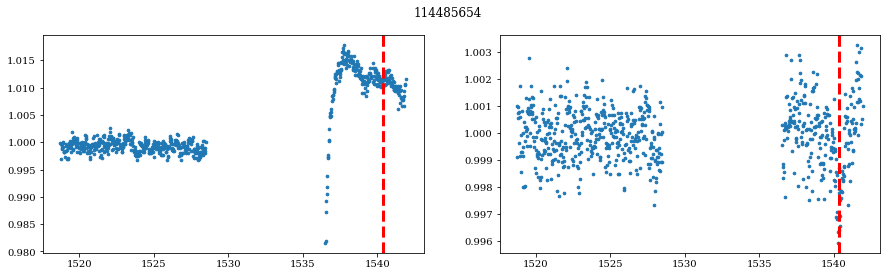

255592513


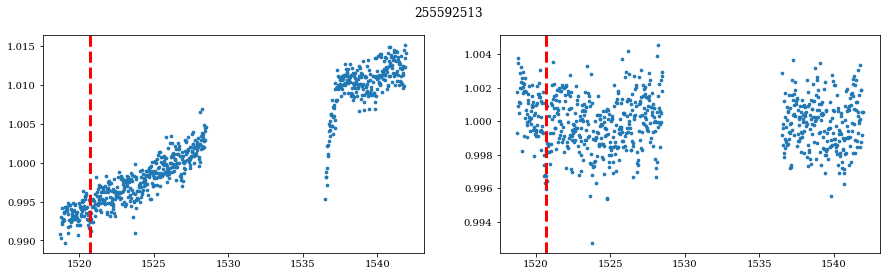

130792292


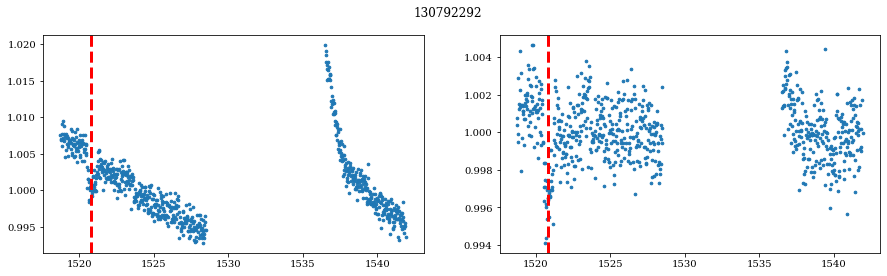

349766841


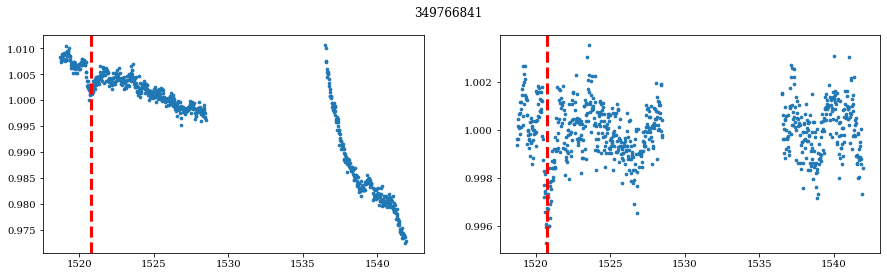

341851380


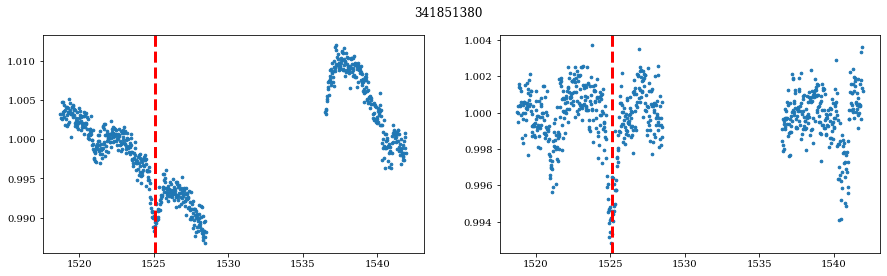

154085887


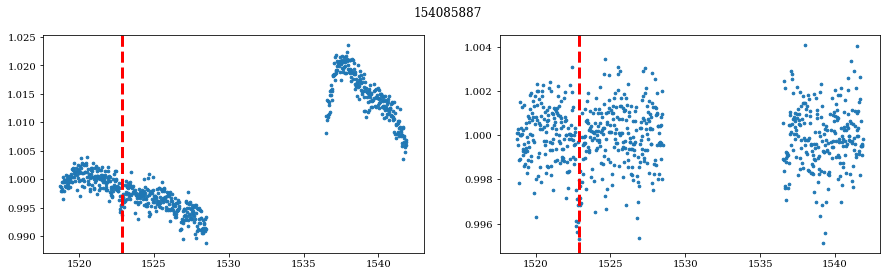

60786134


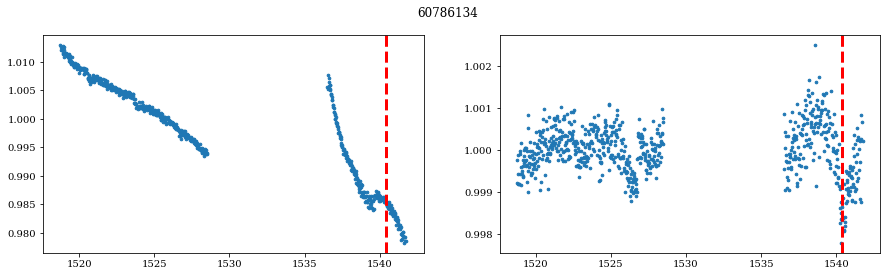

51258267


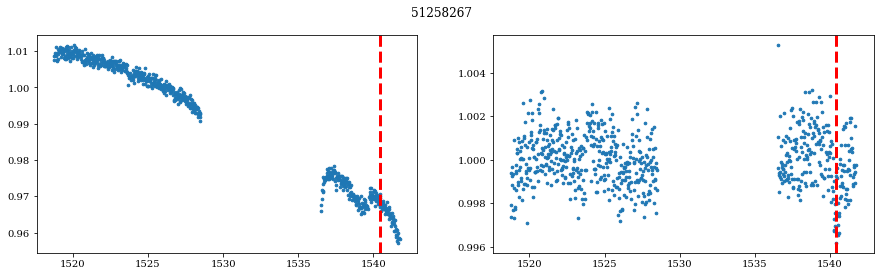

147453162


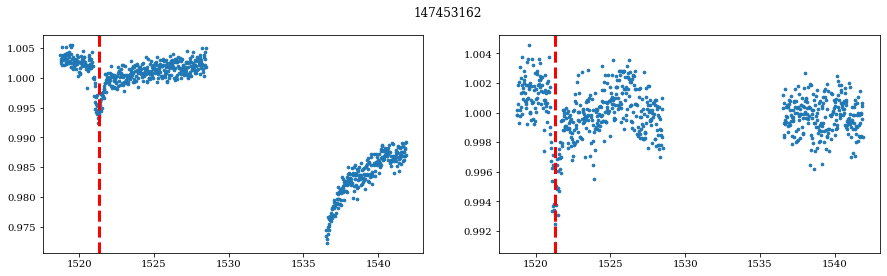

380524790


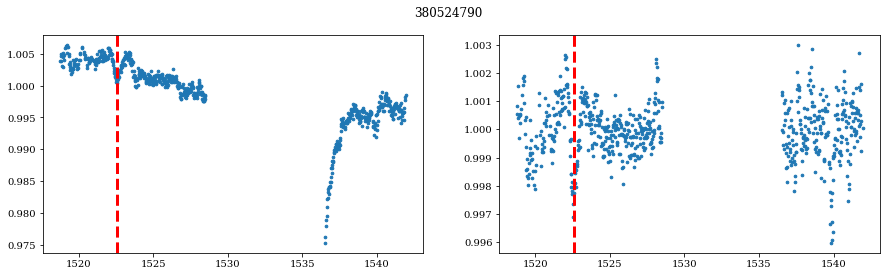

430663414


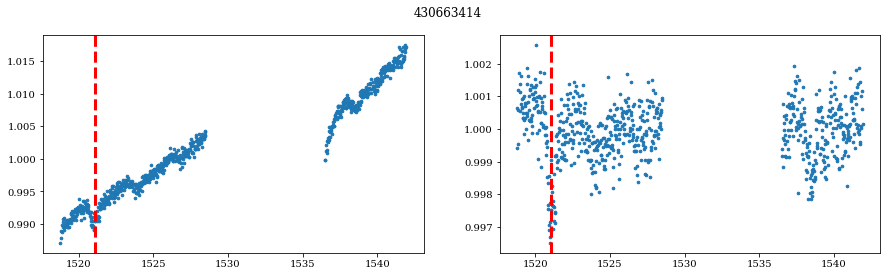

137422498


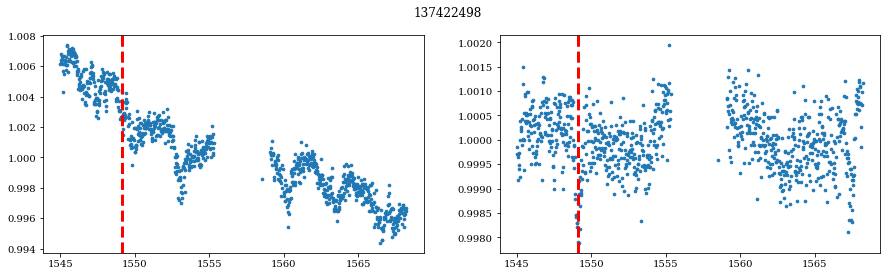

78583769


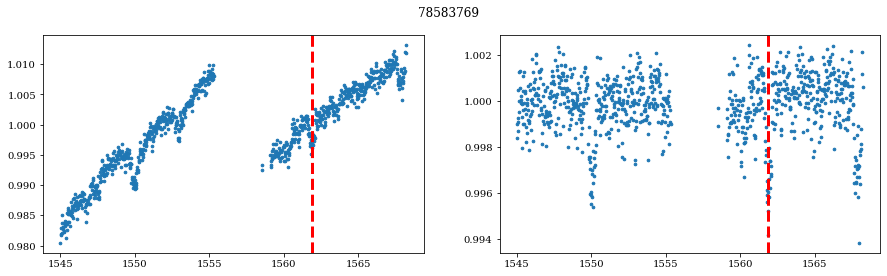

385846821


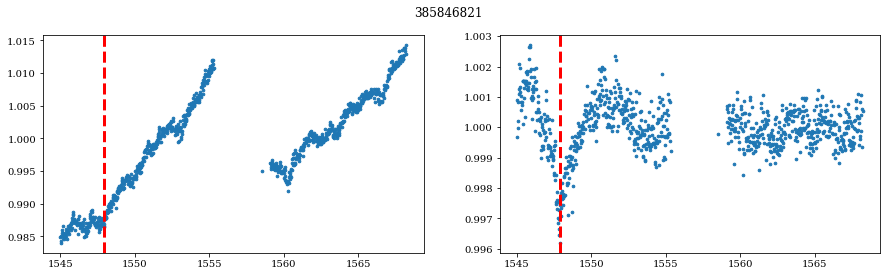

119918912


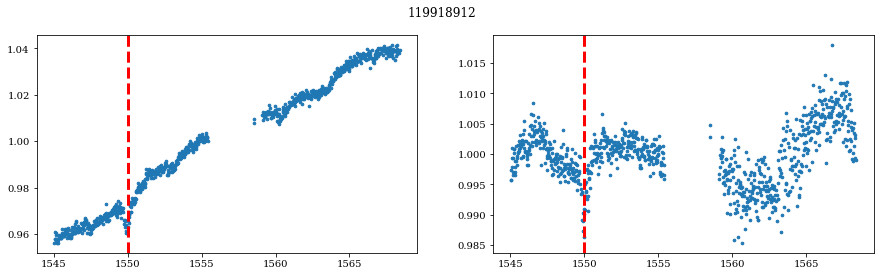

146754513


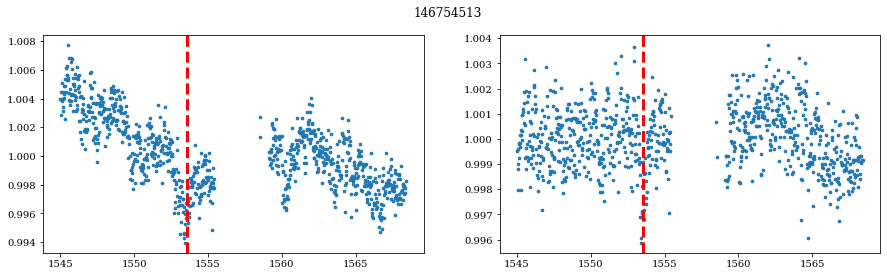

463403441


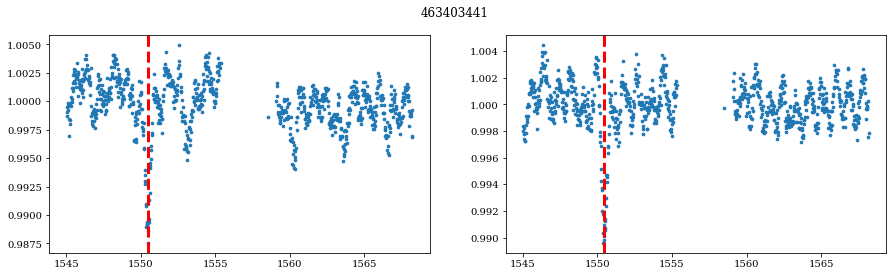

45968174


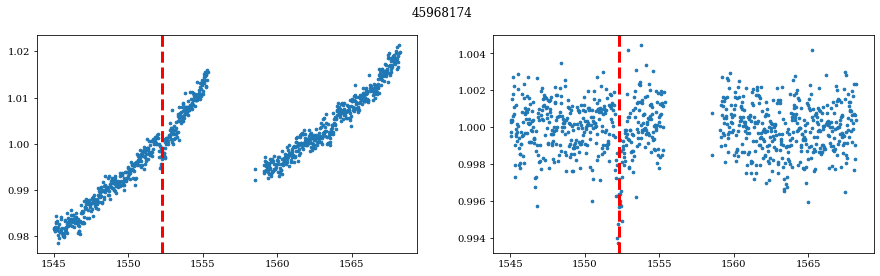

462025224


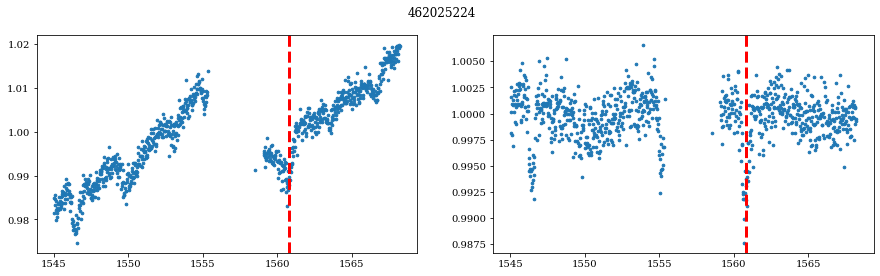

70822370


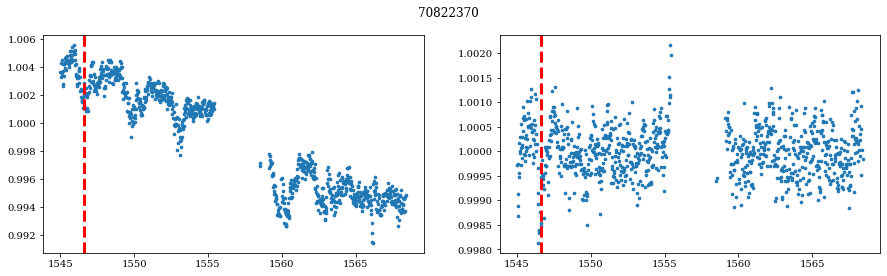

324994660


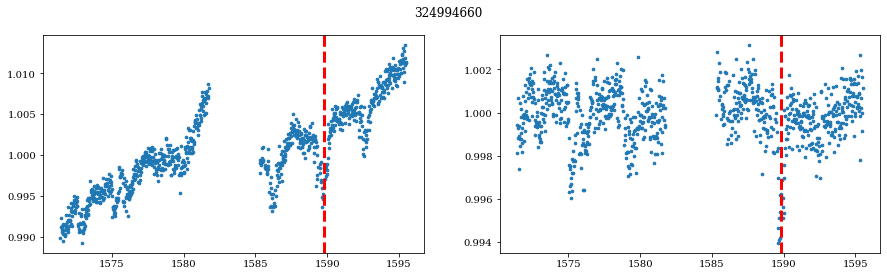

465217594


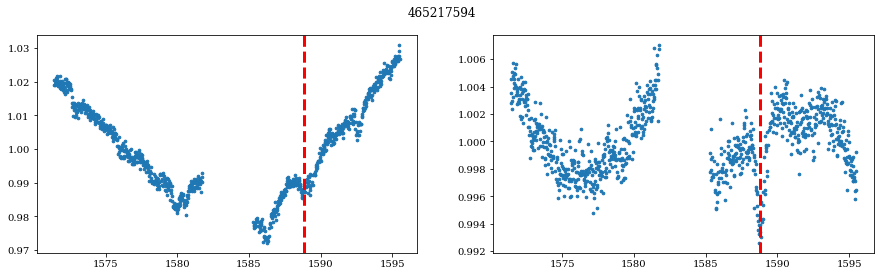

324284463


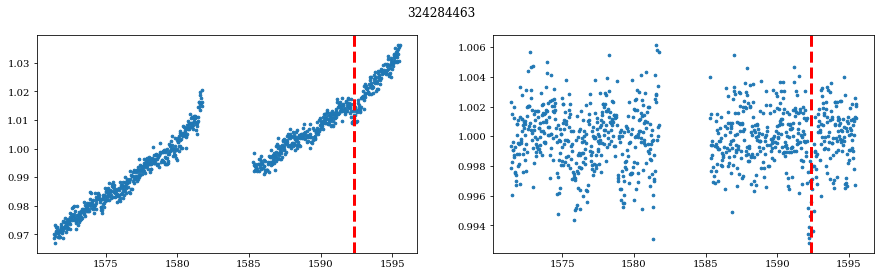

465217608


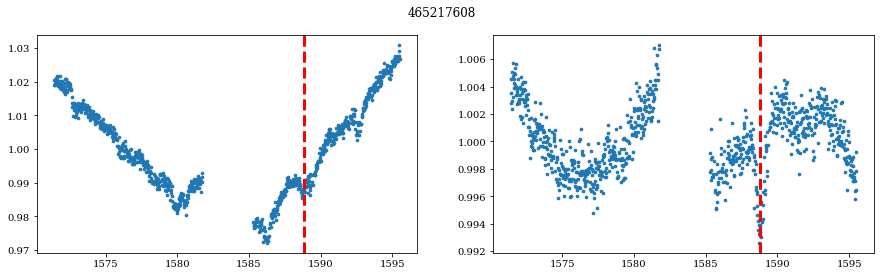

466631808


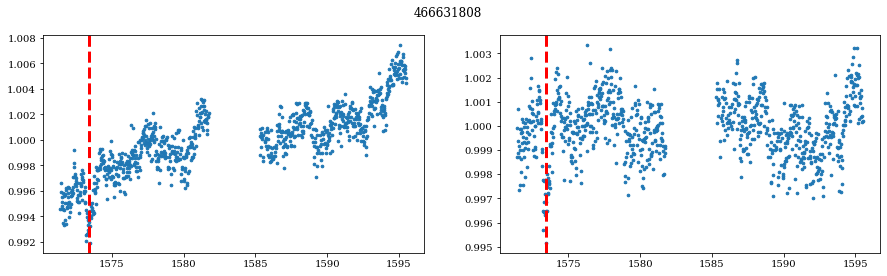

468099453


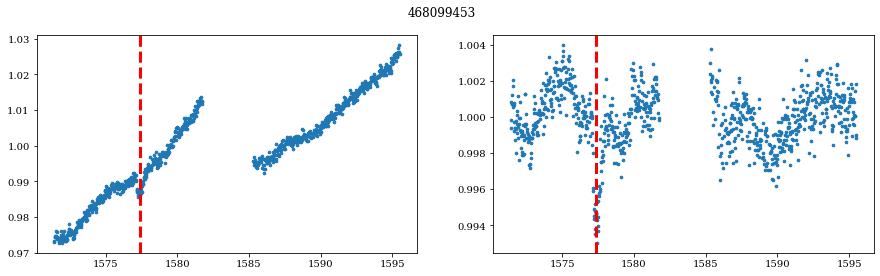

458857264


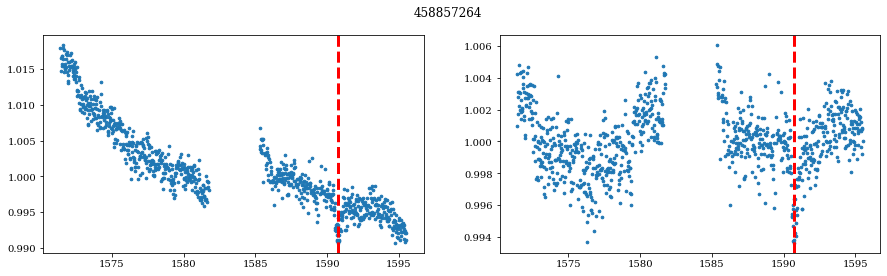

370495920


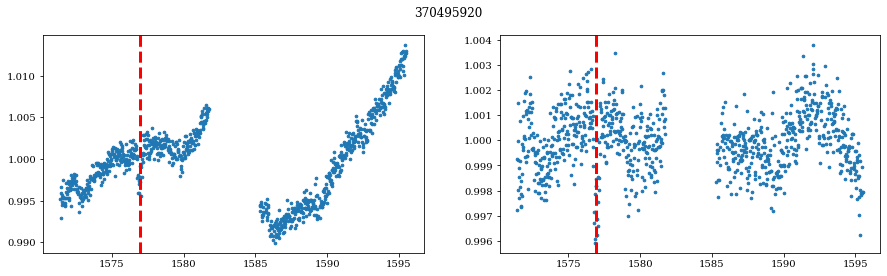

464977570


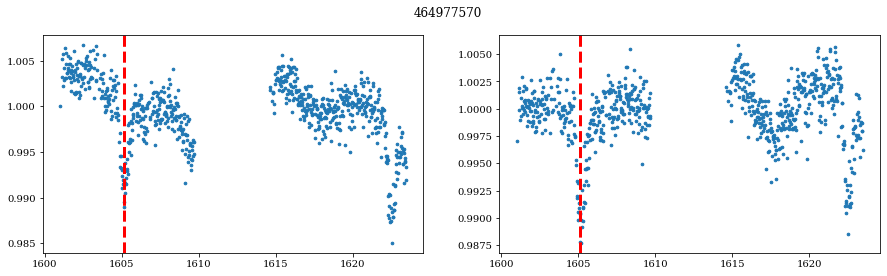

443470267


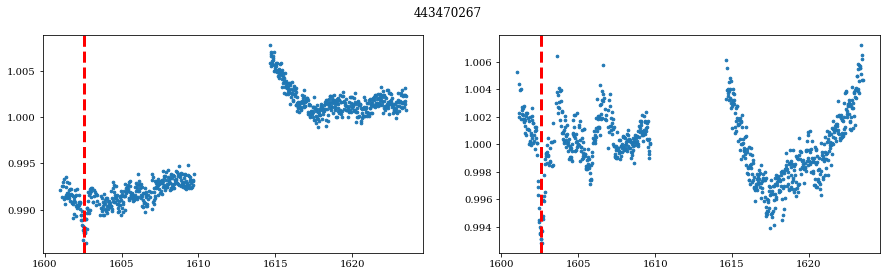

210809448


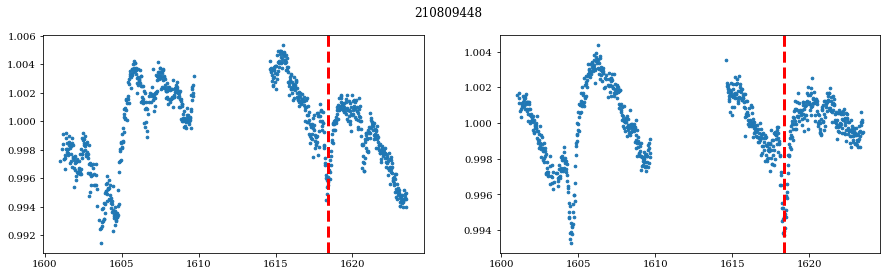

331181266


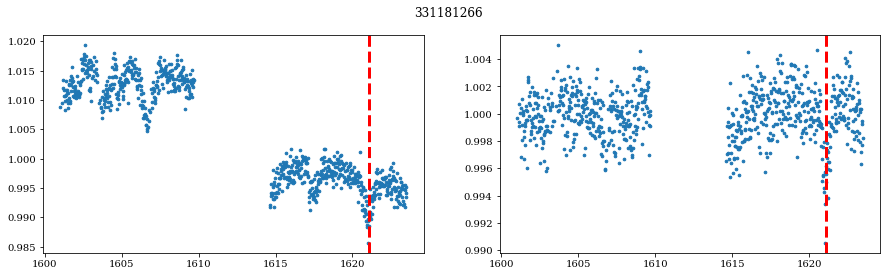

467316746


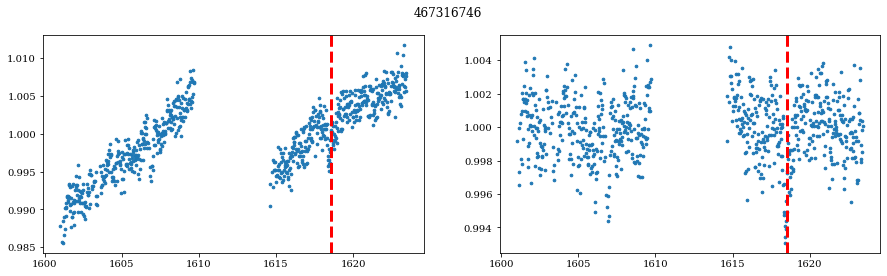

121311369


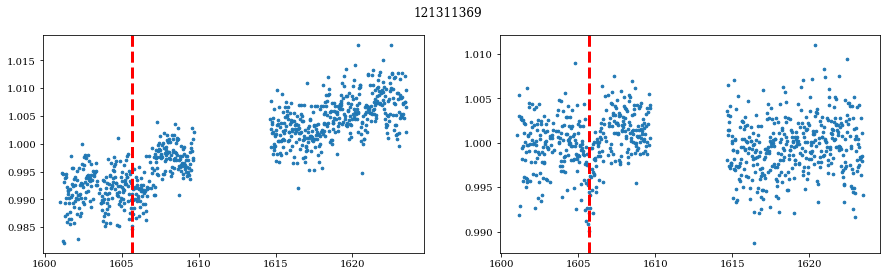

406327621


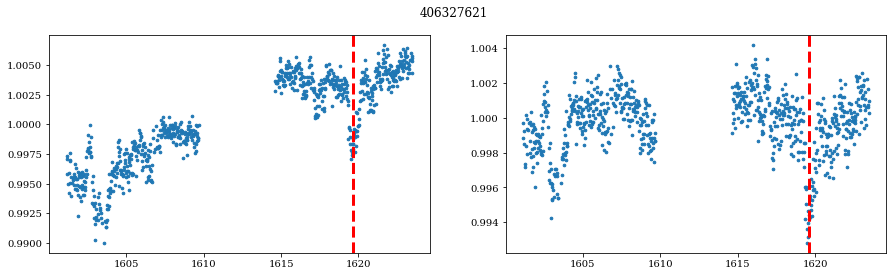

256008565


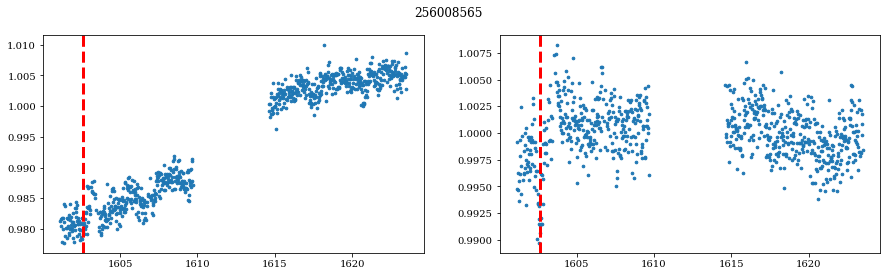

400479765


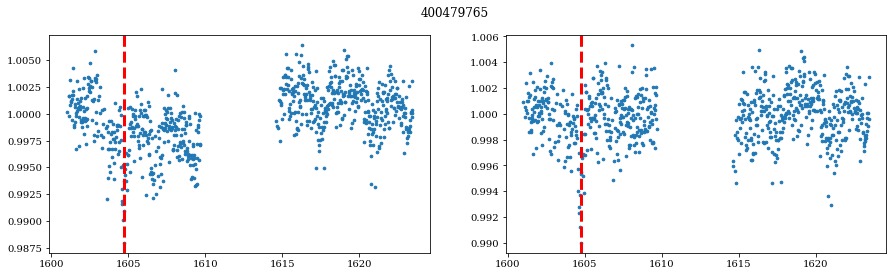

329538924


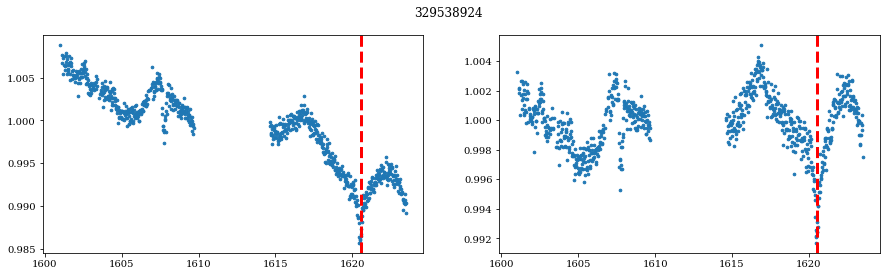

382672899


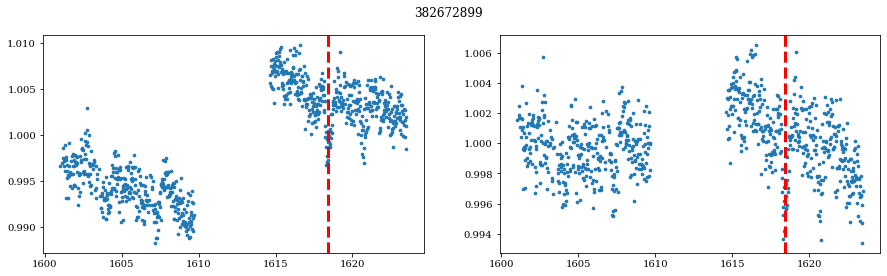

304687284


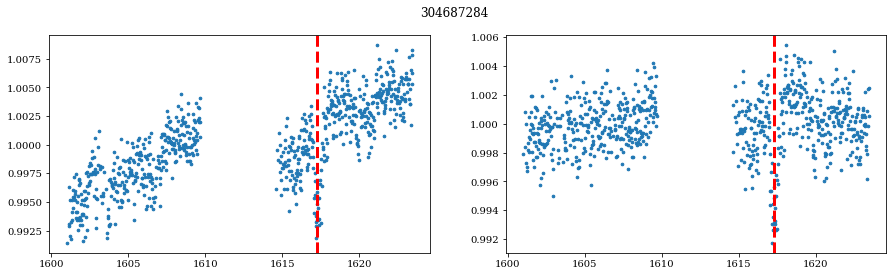

312314132


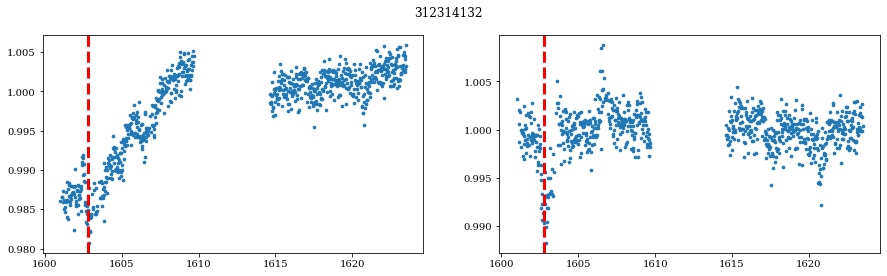

323427650


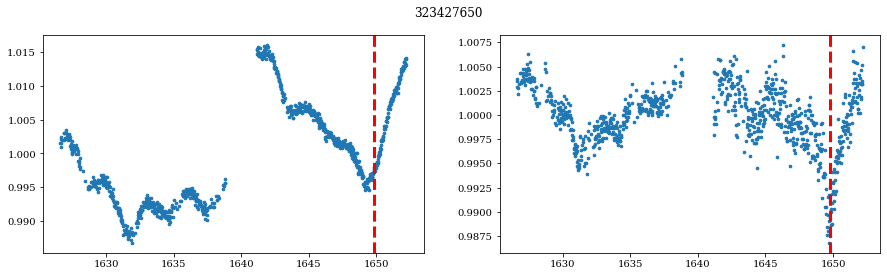

151388324


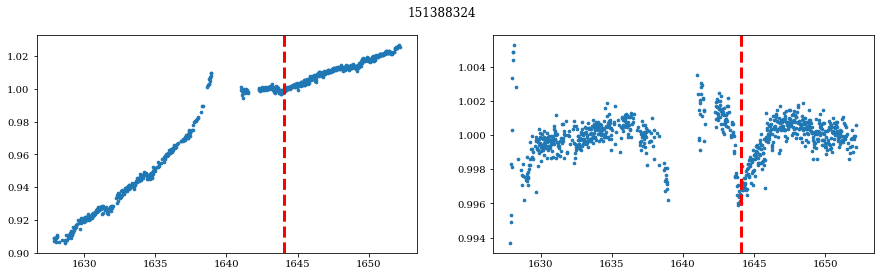

382042593


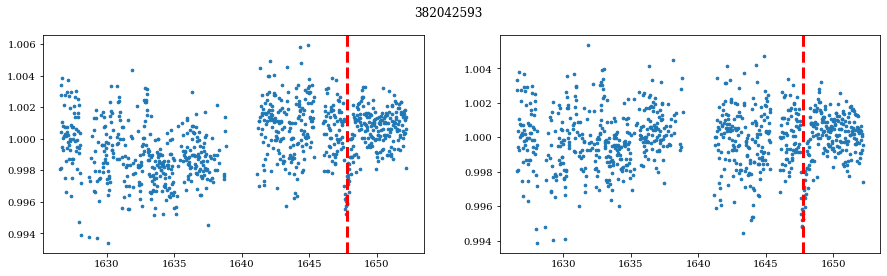

17061633


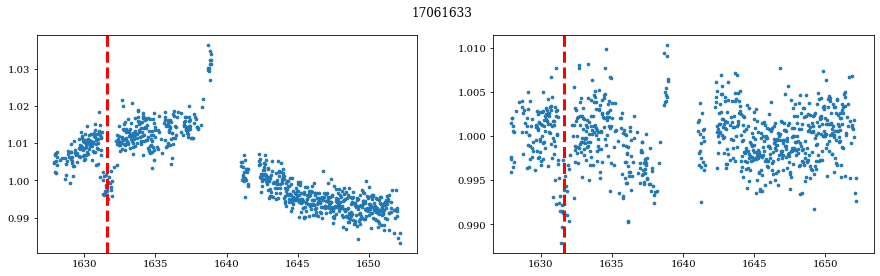

73149665


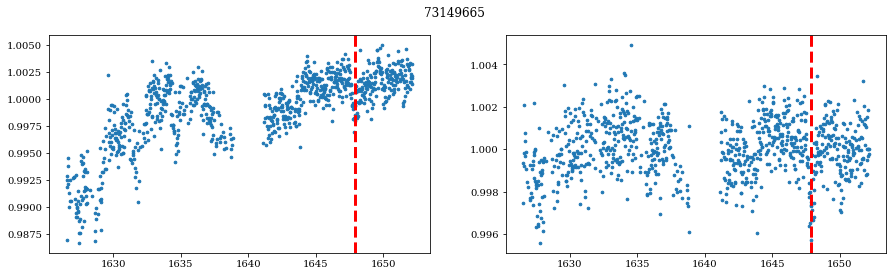

45487909


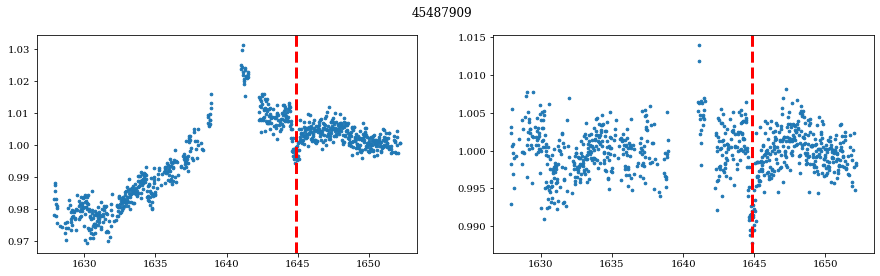

47032443


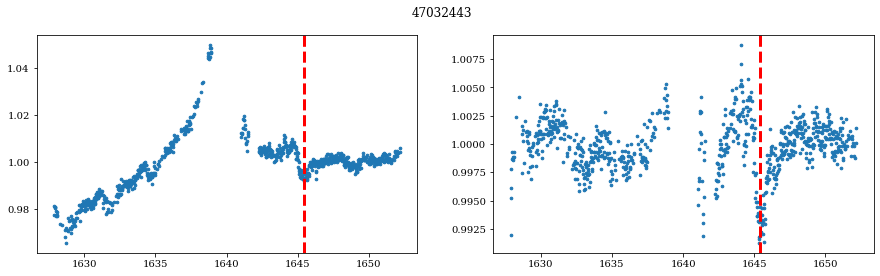

38486019


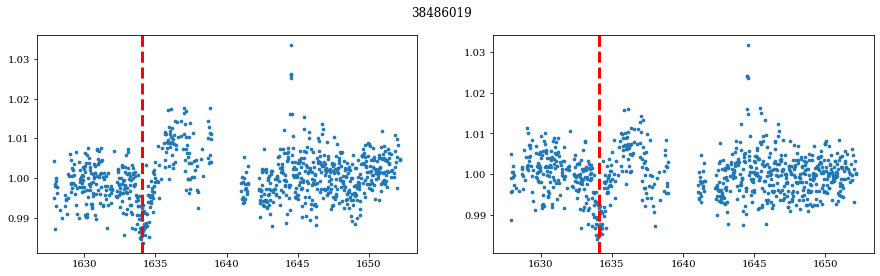

58481307


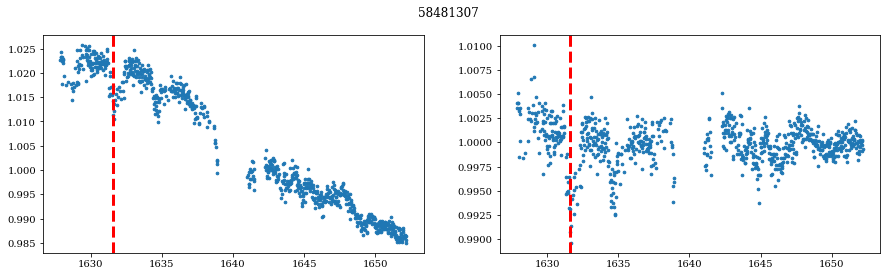

423586149


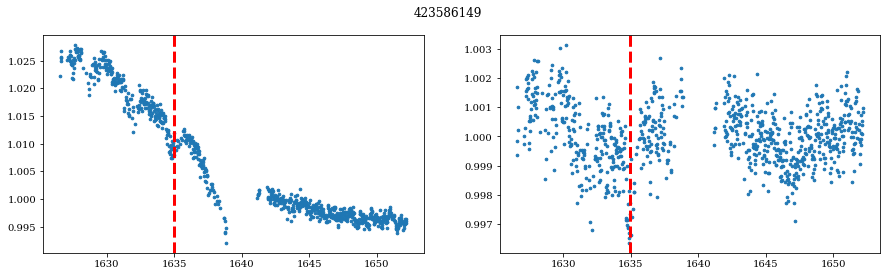

258491112


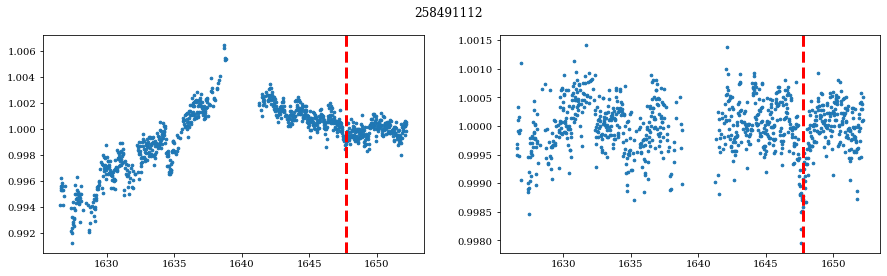

41895270


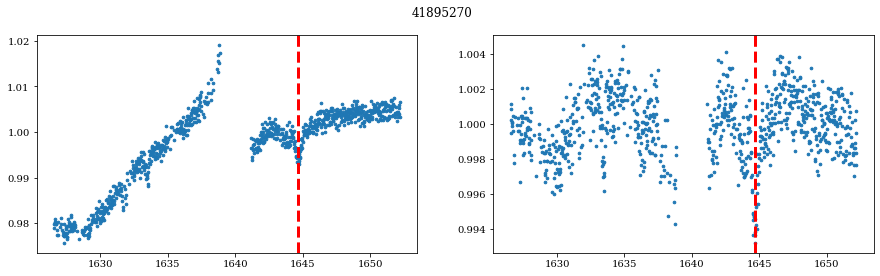

150941110


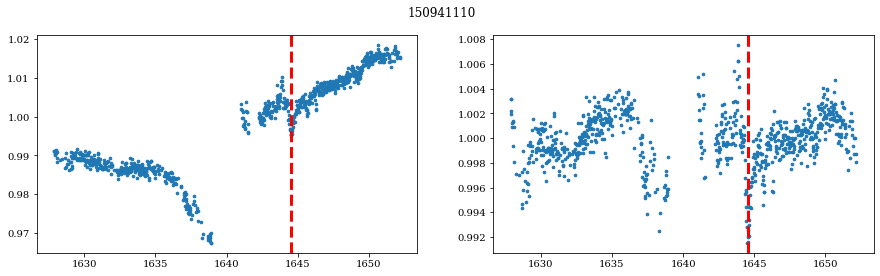

225065556


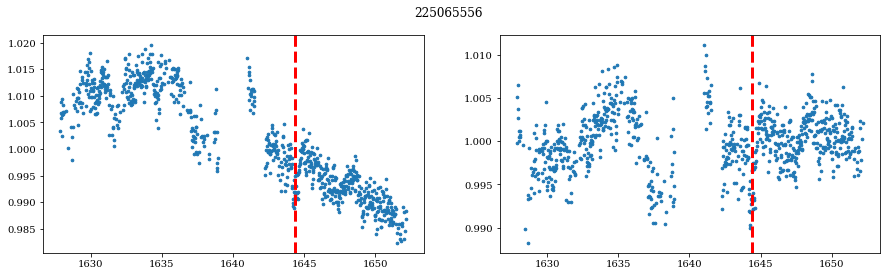

55652757


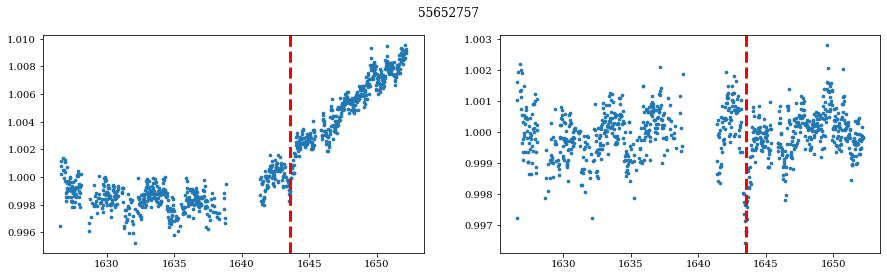

271601262


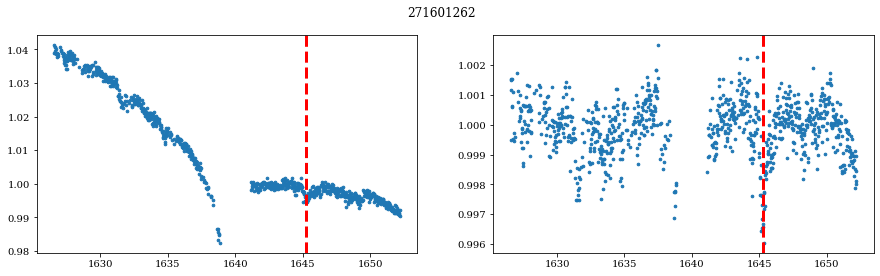

150725982


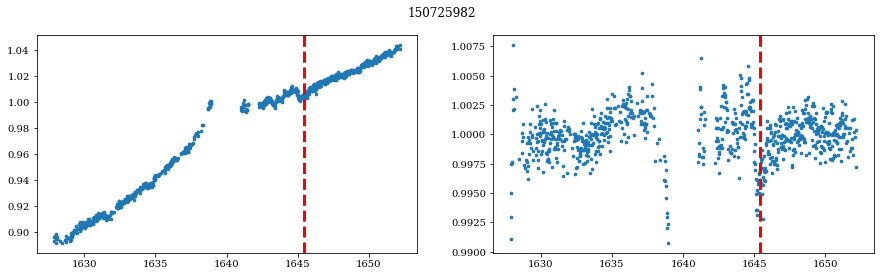

396722964


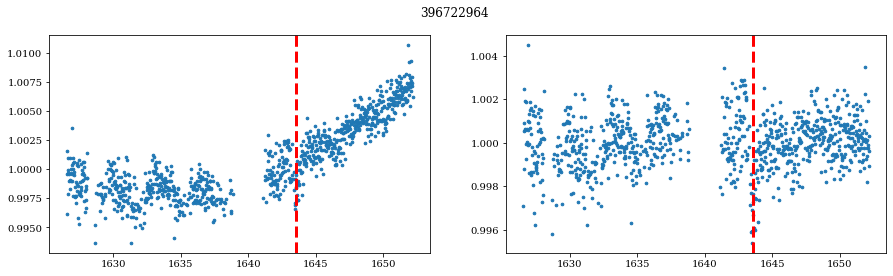

287635488


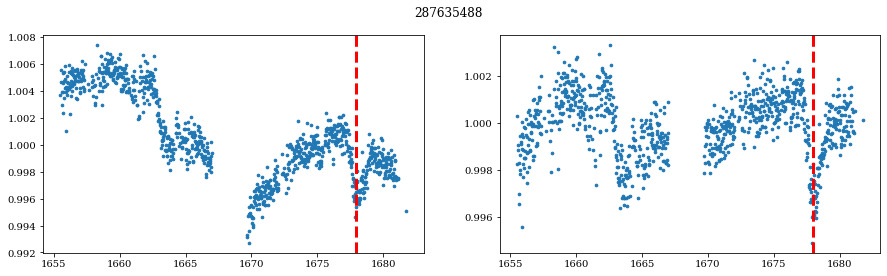

300559863


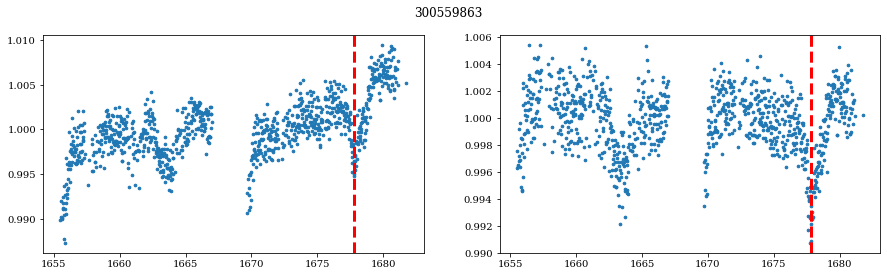

300600330


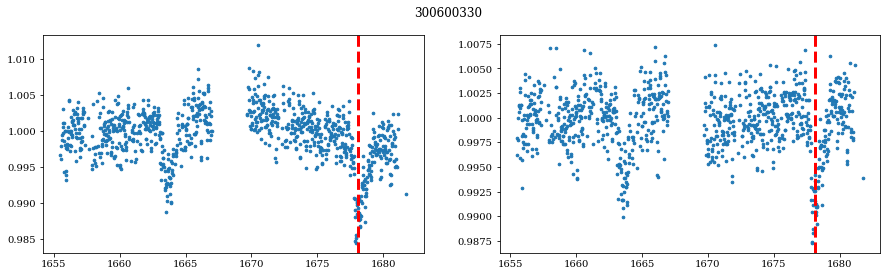

372205034


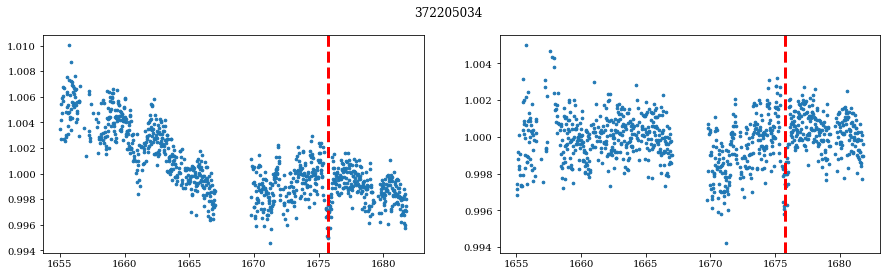

422137017


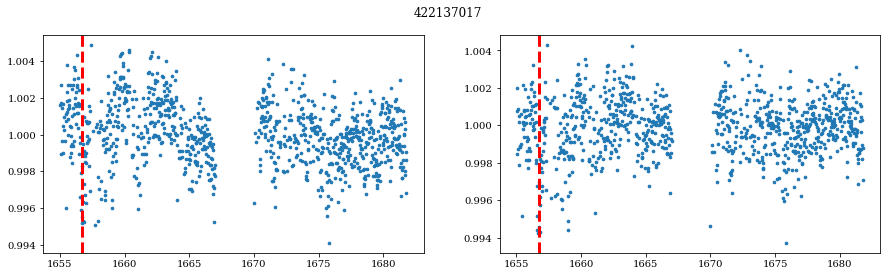

327711511


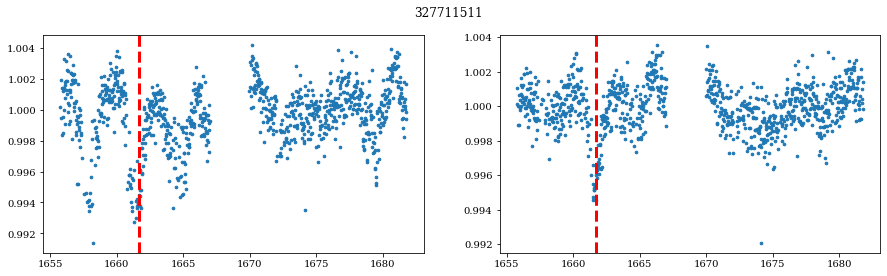

350822925


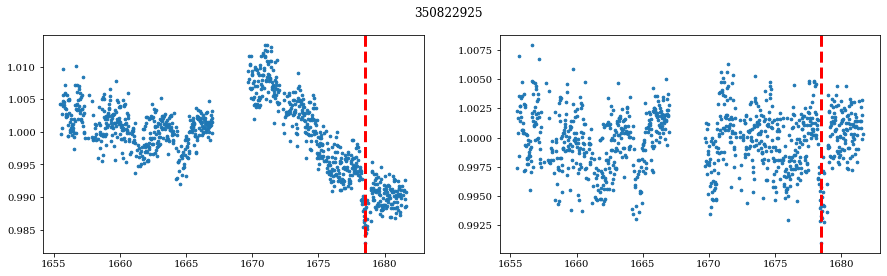

349754526


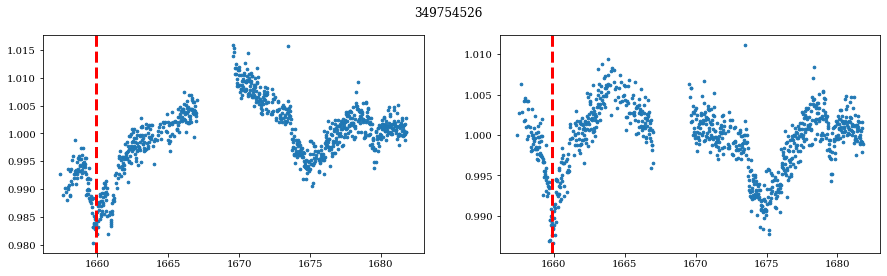

452513341


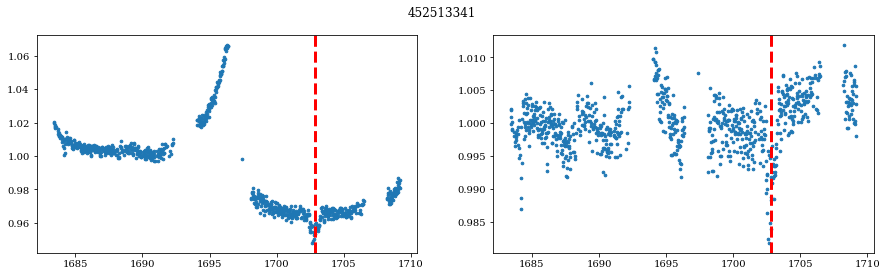

229790952


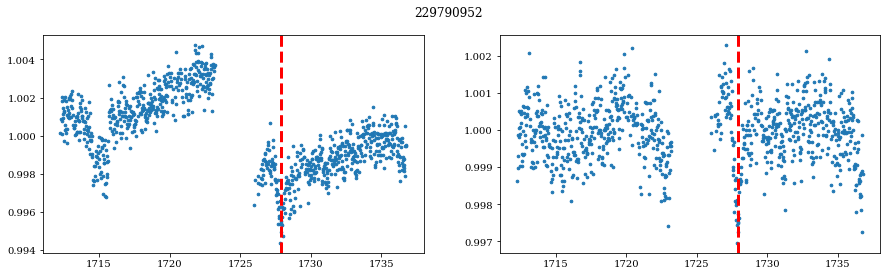

365318396


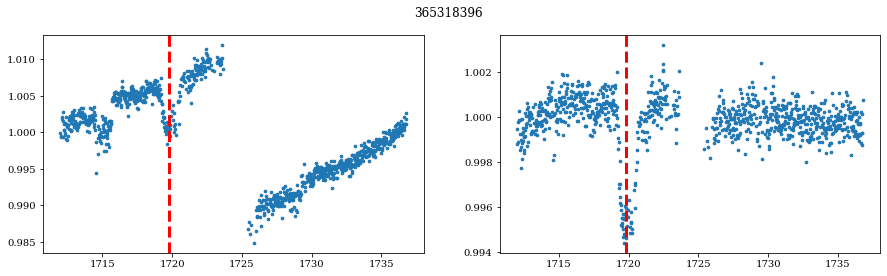

141861400


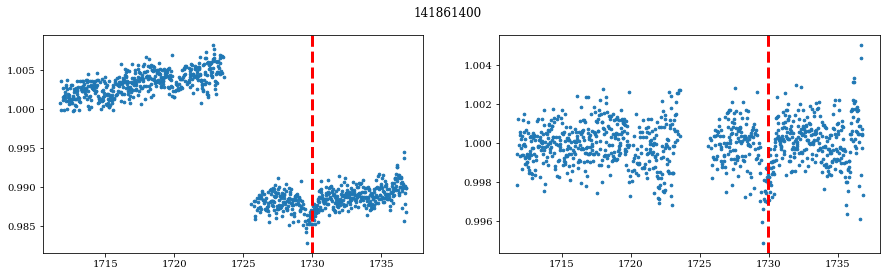

159613292


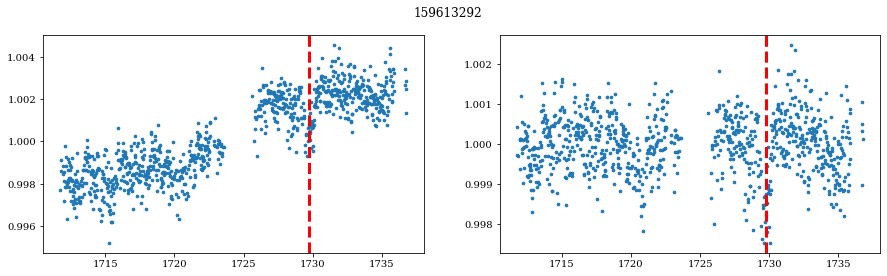

171410431


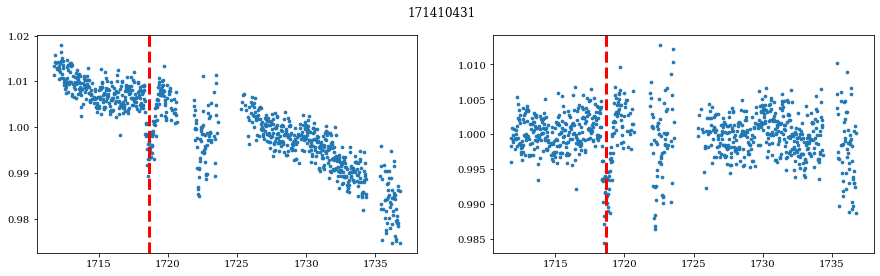

229972744


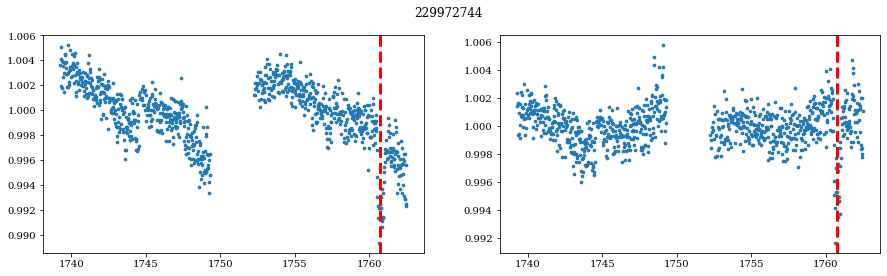

197483992


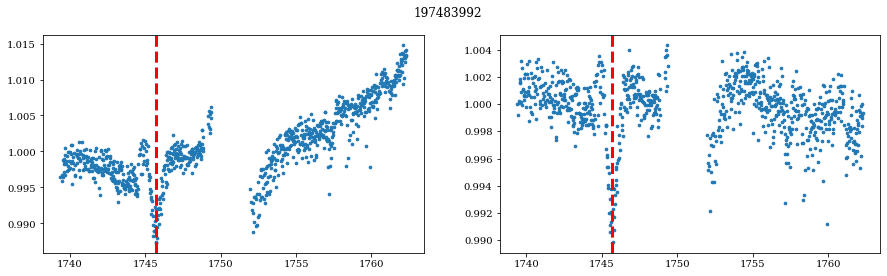

27349467


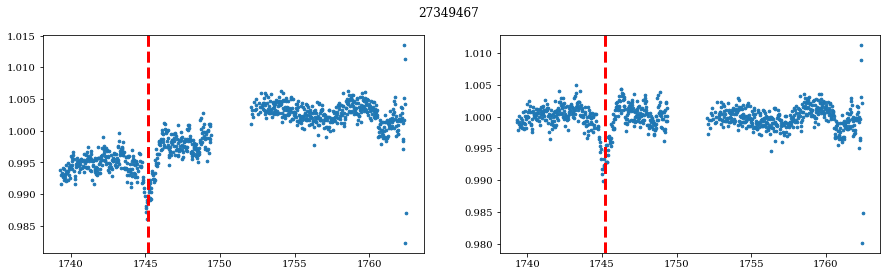

27351374


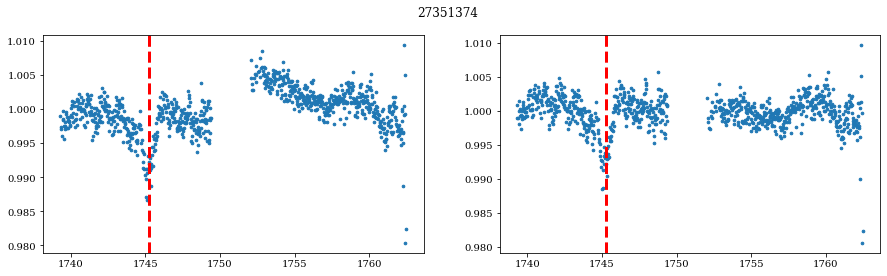

364175700


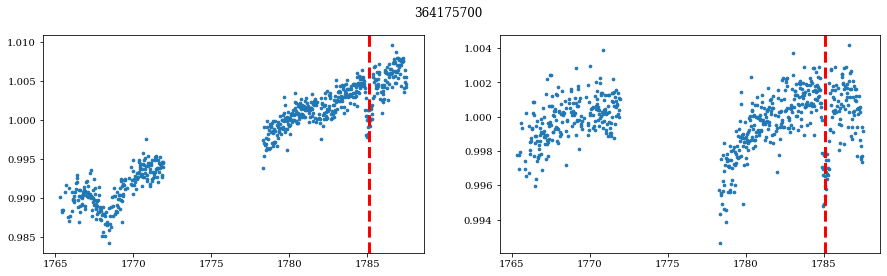

2047187854


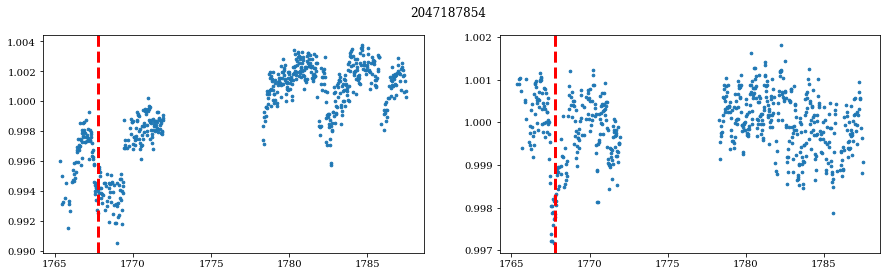

314965603


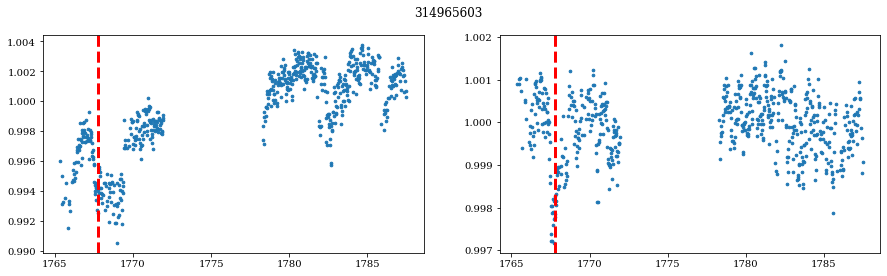

287268010


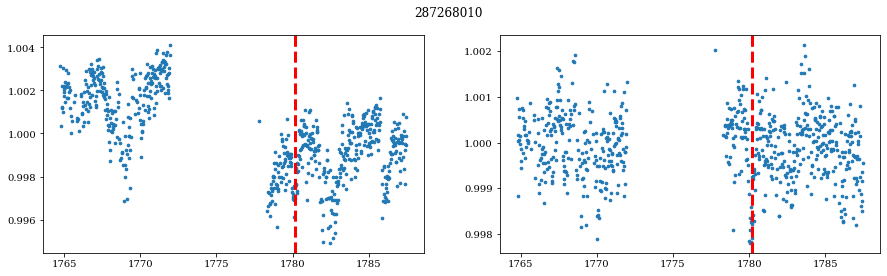

362968405


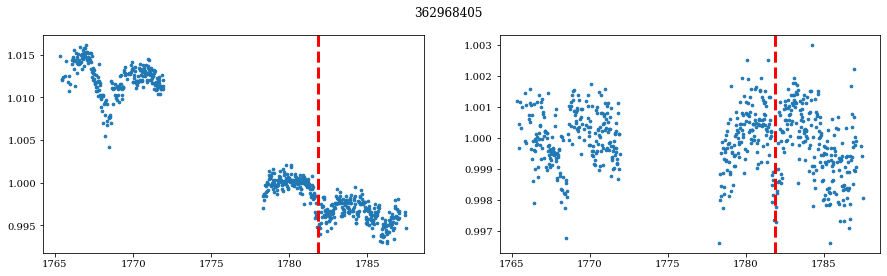

430459104


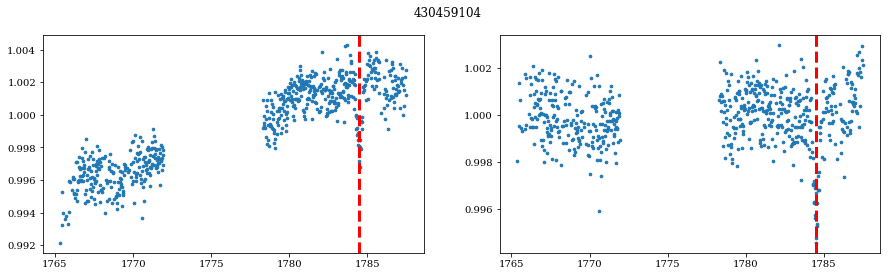

467322214


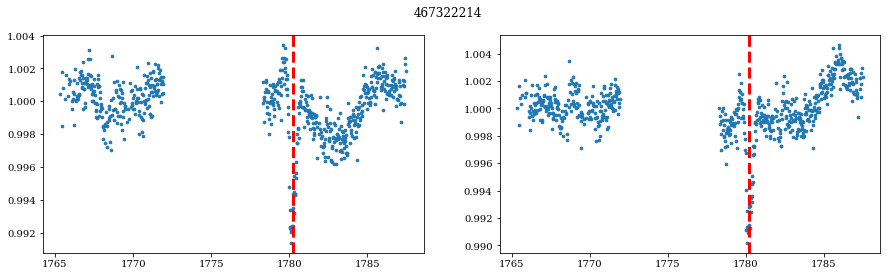

348444547


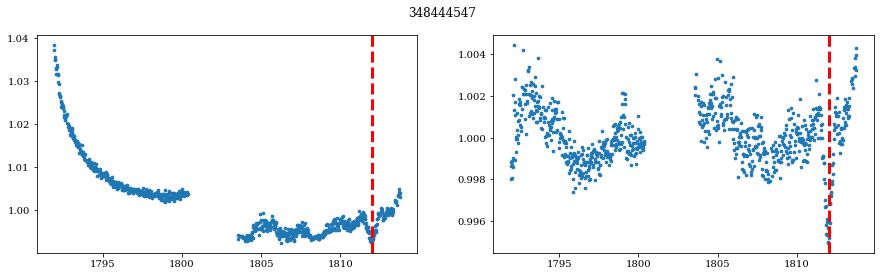

94335925


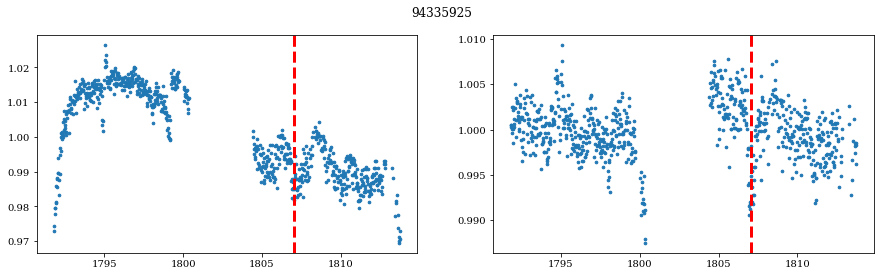

445437175


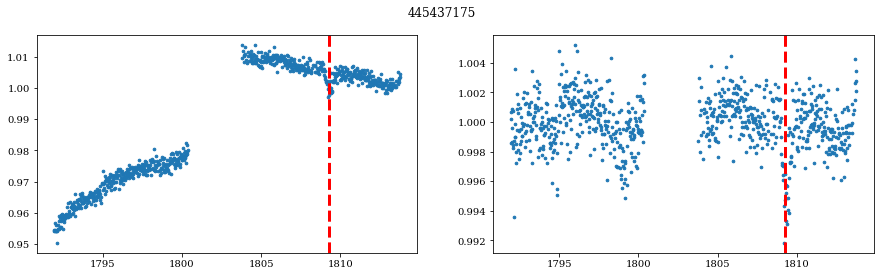

261620577


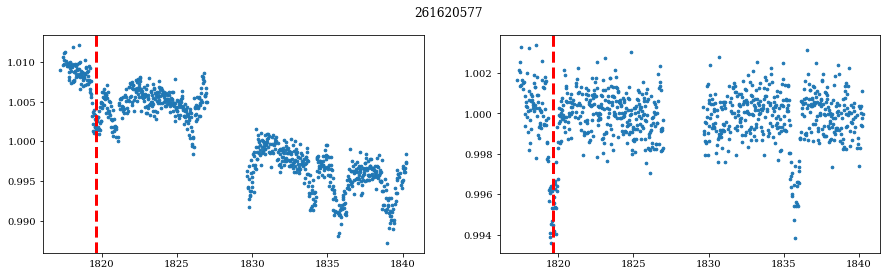

267059351


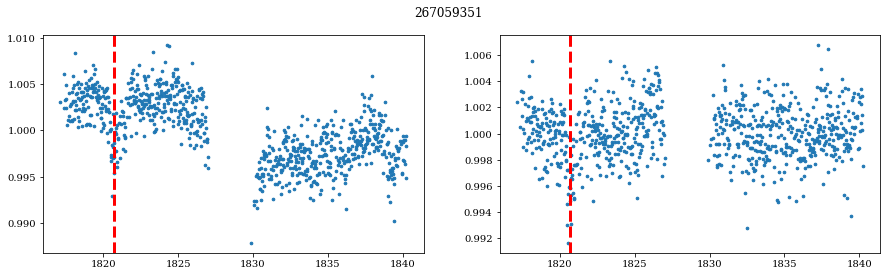

264722404


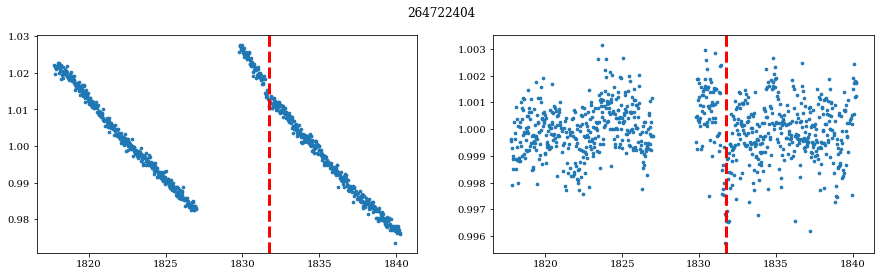

286109025


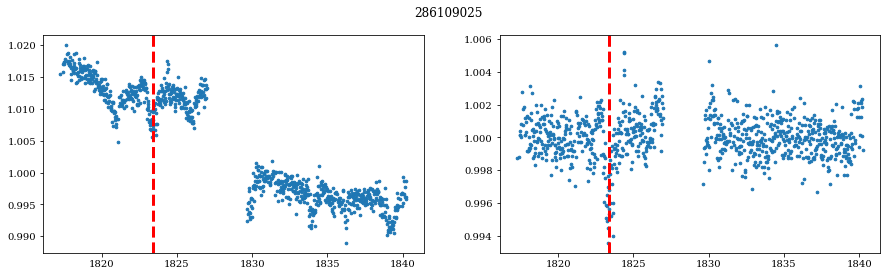

264722407


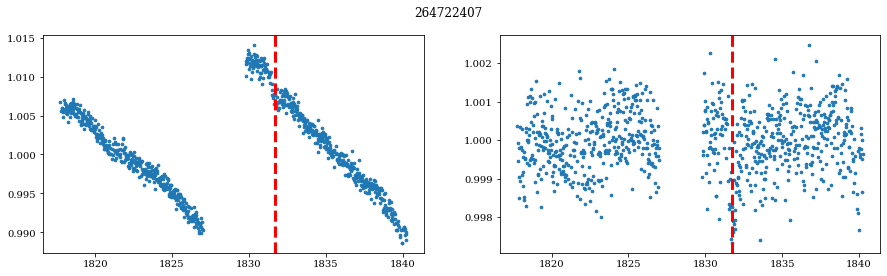

470310358


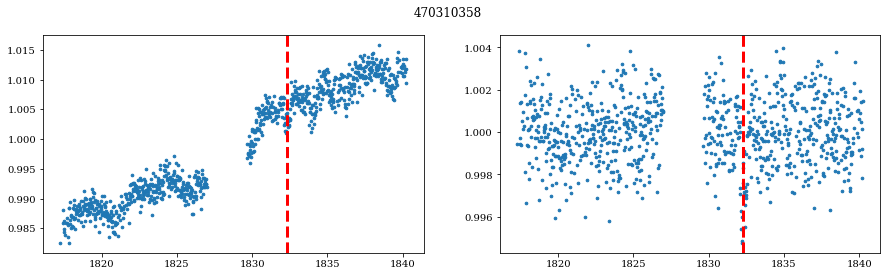

104660187


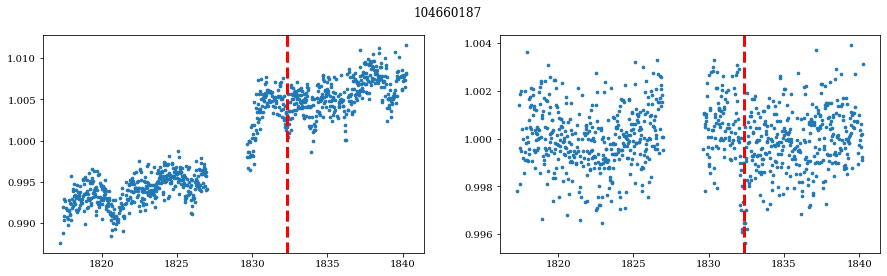

104747212


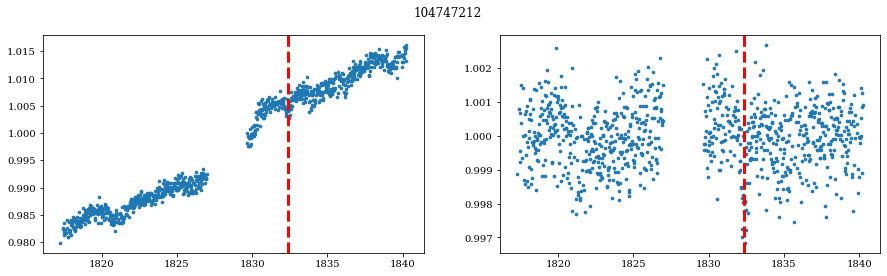

286617549


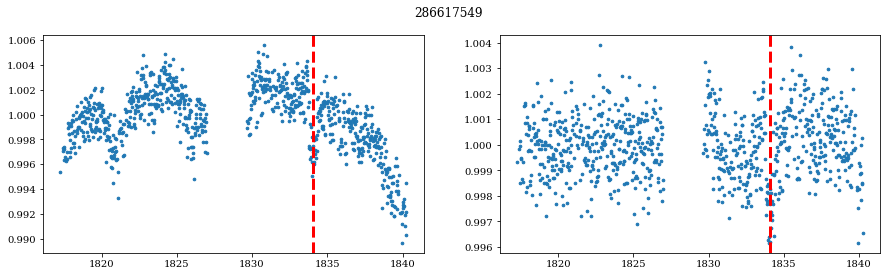

468669059


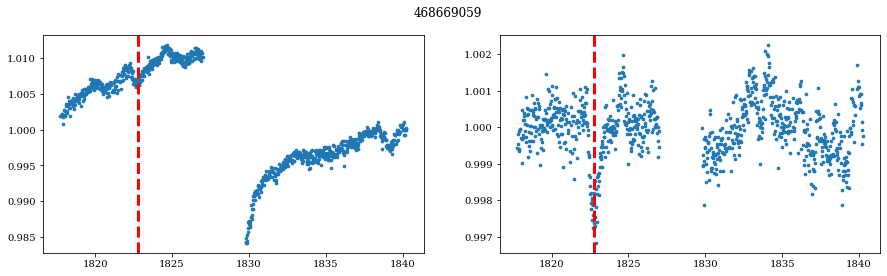

286108967


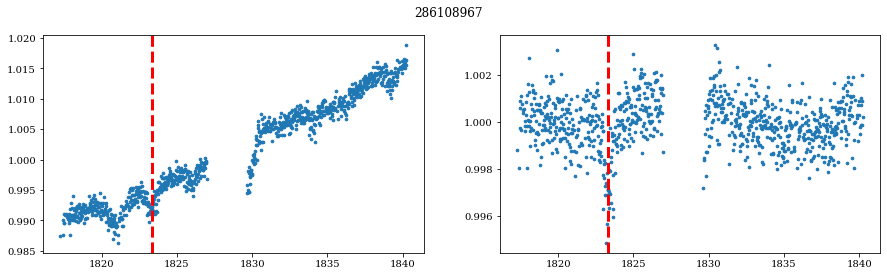

115392511


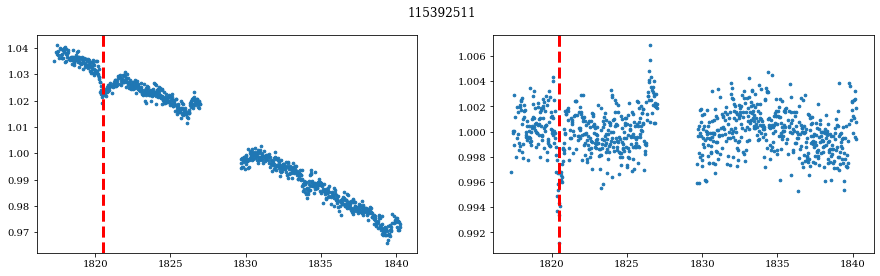

266501197


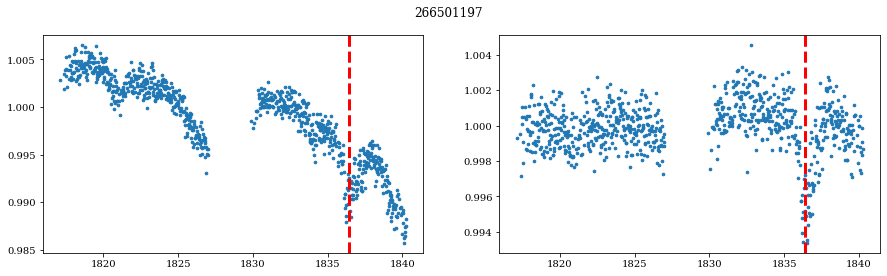

192071317


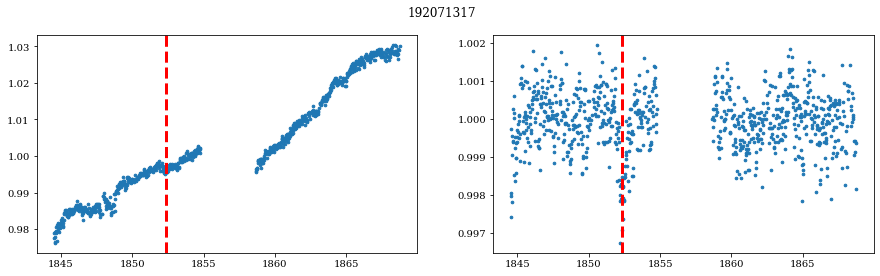

341687821


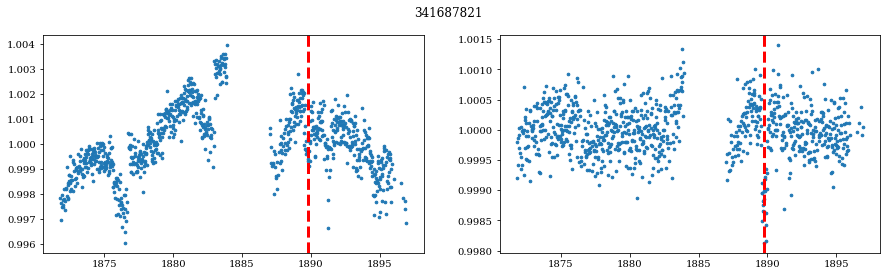

232676838


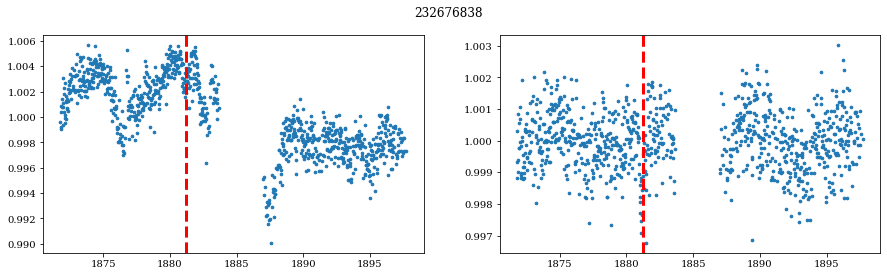

148838714


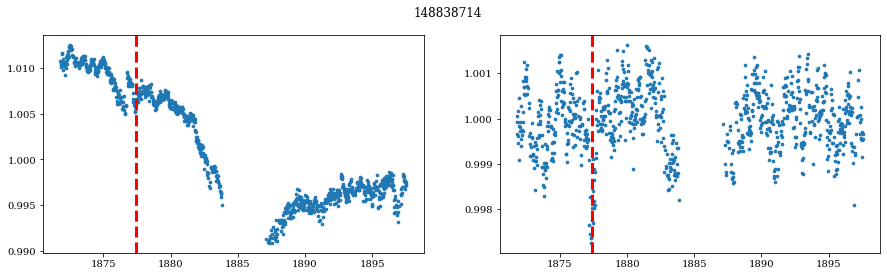

159241240


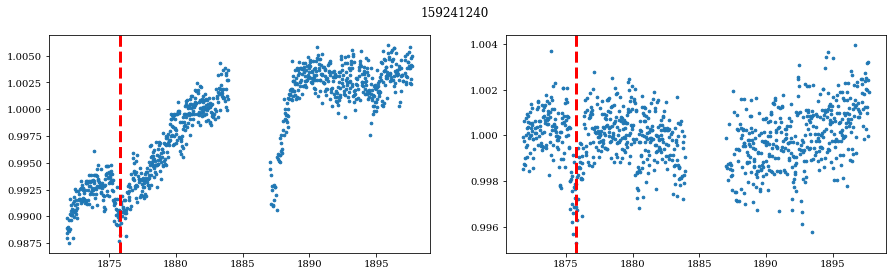

172537093


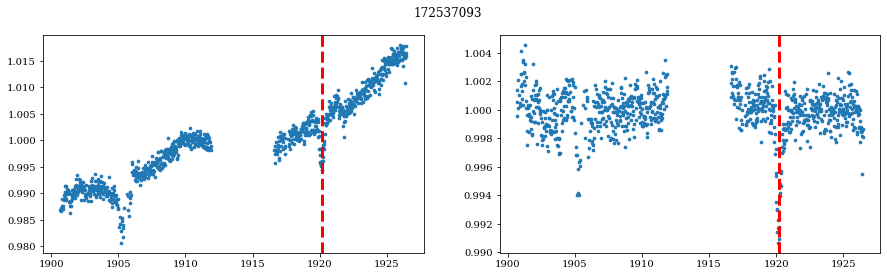

353818032


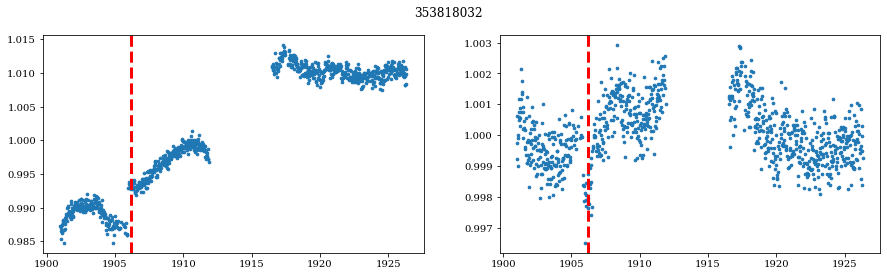

172537088


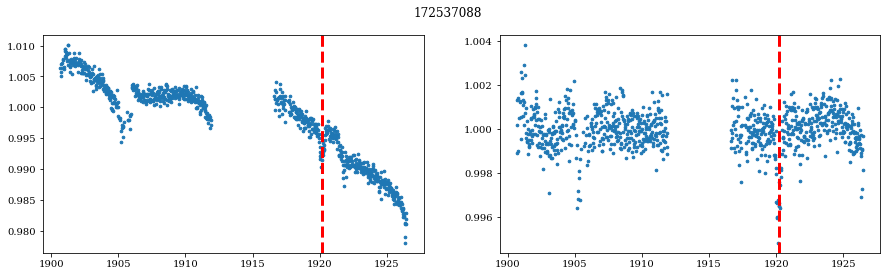

357349252


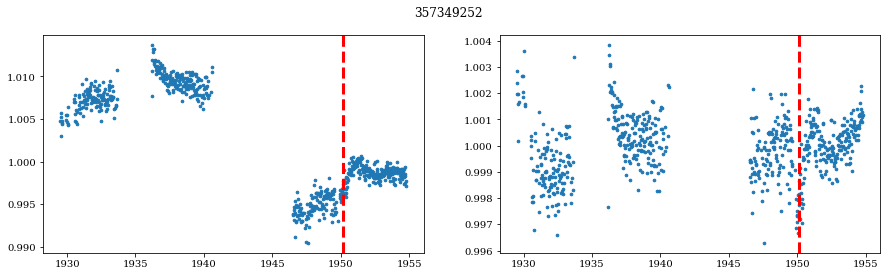

271238705


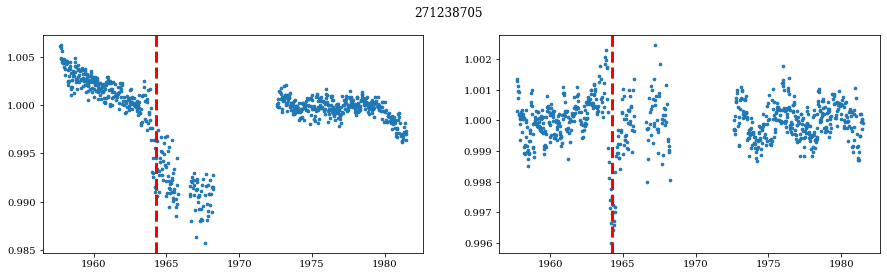

314708500


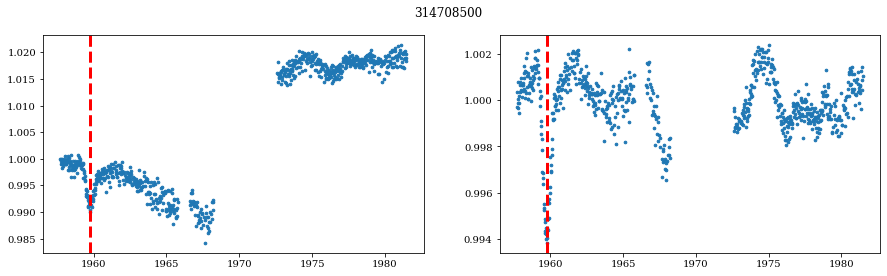

357743808


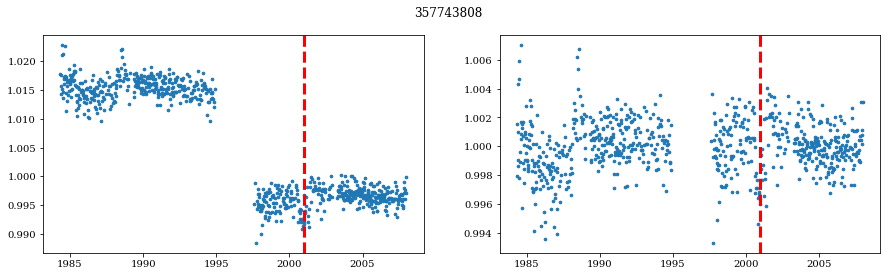

427641483


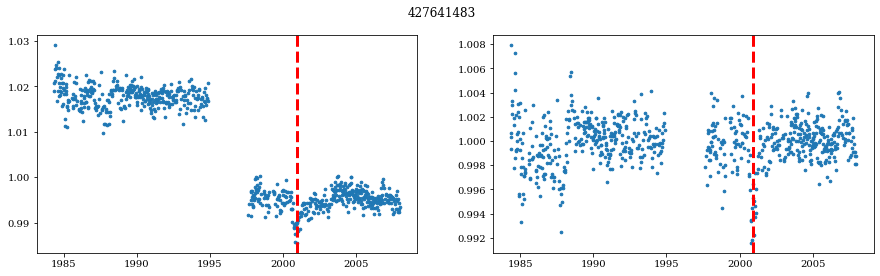

427641495


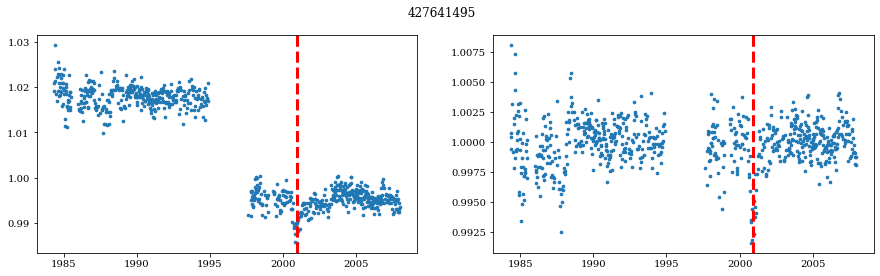

352285168


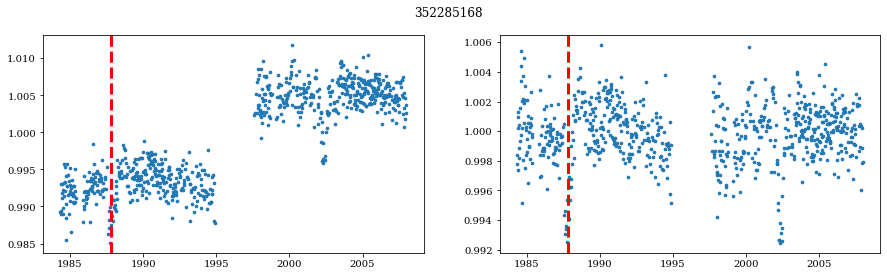

357889803


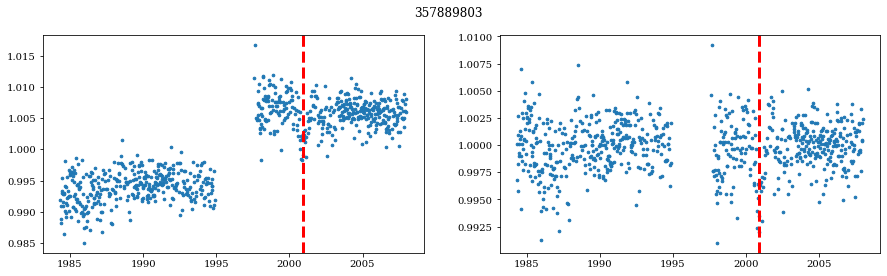

In [39]:
for i in data[data['class'] == 'red'].abs_path: #4 x 4 grid for illustration purposes
    #print(len(data_new[(data_new.asym_score >=0.9) & (data_new.asym_score <= 1) & (abs(data_new.depth) >= 0.1)]))
    lc, lc_info = import_lightcurve(i)
    lc = lc['TIME','PCA_FLUX','QUALITY','FLUX_ERR','FLUX_BKG','X_CENTROID','Y_CENTROID','CORR_FLUX','RAW_FLUX']
    fig, ax = plt.subplots(1,2,figsize=(15,4))
    print(lc_info[0])
    ax[0].scatter(lc['TIME'],lc['RAW_FLUX']/np.median(lc['RAW_FLUX']),s=7)
    ax[0].axvline(data[data.TIC_ID == lc_info[0]].time.values[0],linestyle='--',linewidth=3,color='red')
    ax[1].scatter(lc['TIME'],lc['PCA_FLUX']/np.median(lc['PCA_FLUX']),s=7)
    ax[1].axvline(data[data.TIC_ID == lc_info[0]].time.values[0],linestyle='--',linewidth=3,color='red')
    #_, _ = processing(lc,lc_info=lc_info,method='median',make_plots=True)
    fig.suptitle(f"{lc_info[0]}")
    plt.show()

In [40]:
tics = data[data['class'] == 'red'].TIC_ID.values
sector = data[data['class'] == 'red'].Sector.values

In [41]:
lightcurves_dict = {}

for tic_id, current_sector in zip(tics, sector):
    try:
        search_result = lk.search_lightcurve(f"TIC {tic_id}", mission="TESS", sector=current_sector, author='TESS-SPOC')
     
        # Assuming you want to download the first light curve file
        lc = search_result.download()
        # Store the light curve in the dictionary with TIC ID as the key
        lightcurves_dict[tic_id] = lc
       
    except Exception as e:
        print(f'Error processing TIC {tic_id} in Sector {current_sector}: {str(e)}')

No data found for target "TIC 406277263".
No data found for target "TIC 382187660".
No data found for target "TIC 389660859".
No data found for target "TIC 37485564".
No data found for target "TIC 373914067".
No data found for target "TIC 382572476".
No data found for target "TIC 131422529".
No data found for target "TIC 146626827".
No data found for target "TIC 80551703".
No data found for target "TIC 143152957".
No data found for target "TIC 373913825".
No data found for target "TIC 340004858".
No data found for target "TIC 110969638".
No data found for target "TIC 64953602".
No data found for target "TIC 350843056".
No data found for target "TIC 419365265".
No data found for target "TIC 145276049".
No data found for target "TIC 110610421".
No data found for target "TIC 134743129".
No data found for target "TIC 355773606".
No data found for target "TIC 186056754".
No data found for target "TIC 114485654".
No data found for target "TIC 255592513".
No data found for target "TIC 1307922

In [42]:
lightcurves_dict

{406277263: None,
 382187660: None,
 389660859: None,
 469912242: <TessLightCurve length=1184 LABEL="TIC 469912242" SECTOR=1 AUTHOR=SPOC FLUX_ORIGIN=pdcsap_flux>
        time             flux      ...   pos_corr1      pos_corr2   
                     electron / s  ...      pix            pix      
       object          float32     ...    float32        float32    
 ------------------ -------------- ... -------------- --------------
 1325.3484951830444  2.4876729e+03 ... -2.4668563e-02  1.0241284e-02
  1325.369329064948  2.4888120e+03 ... -2.4639567e-02  1.0045058e-02
 1325.3901629454542  2.4850366e+03 ... -2.4585128e-02  1.0162881e-02
 1325.4109968250295  2.4893367e+03 ... -2.6083756e-02  9.1873994e-03
 1325.4318307036738  2.4899573e+03 ... -2.5086394e-02  9.3997391e-03
 1325.4526645813871  2.4931741e+03 ... -2.5364172e-02  9.7120488e-03
 1325.4734984581692  2.4899170e+03 ... -2.5233524e-02  9.7039146e-03
 1325.4943323340187  2.4894009e+03 ... -2.6323467e-02  7.8505455e-03
 1325.5151

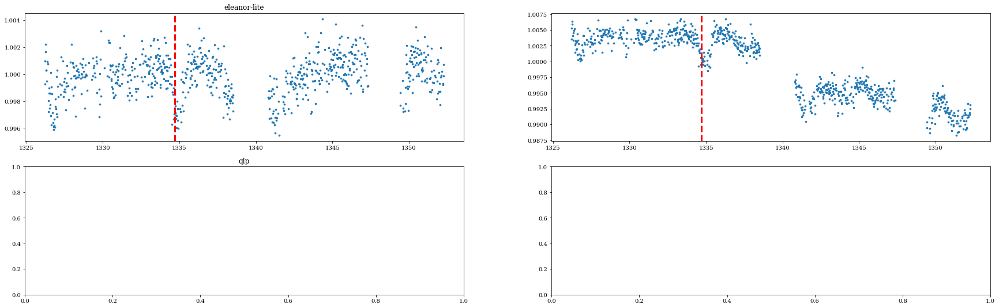

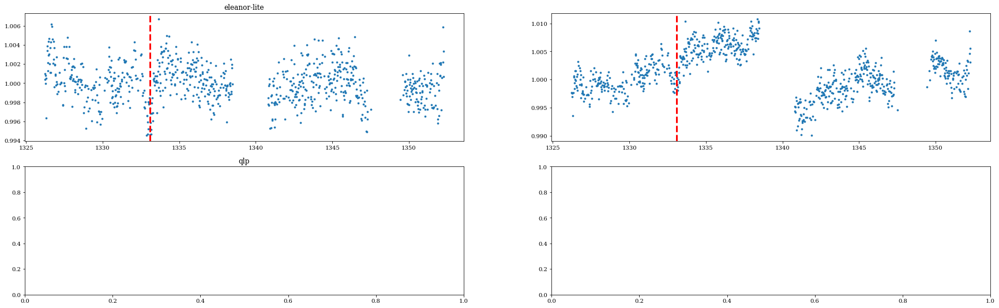

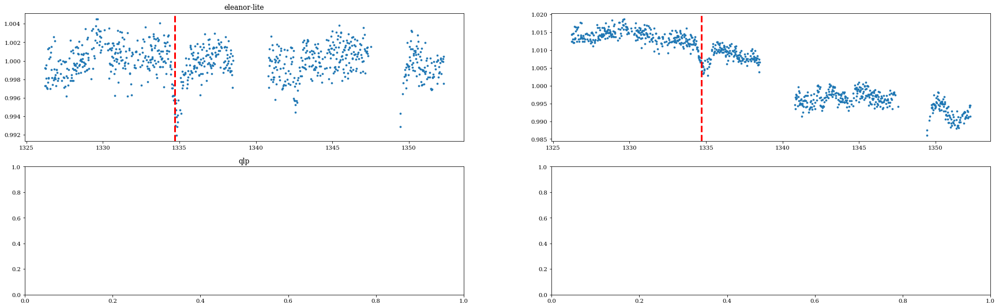

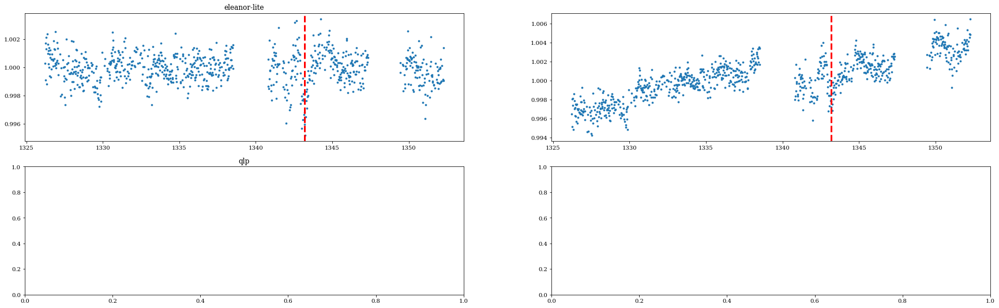

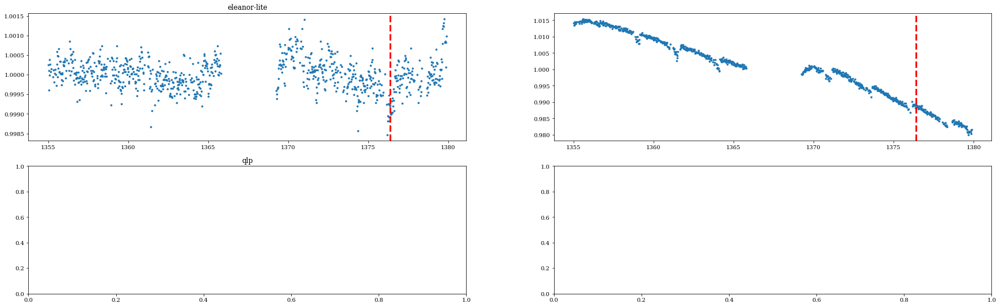

...

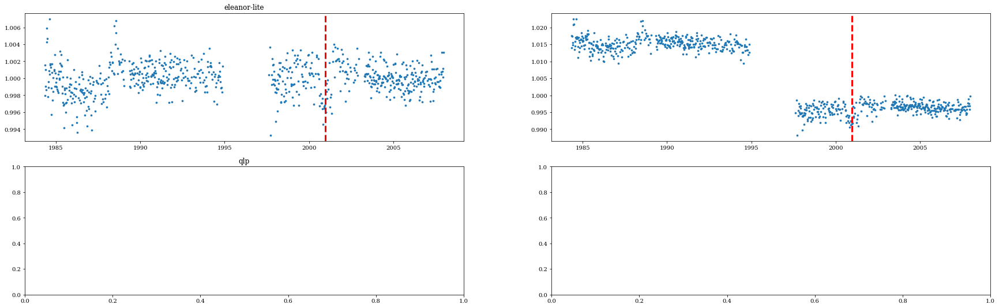

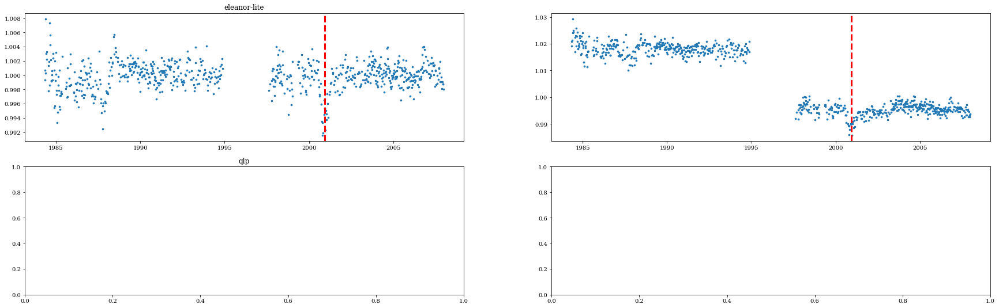

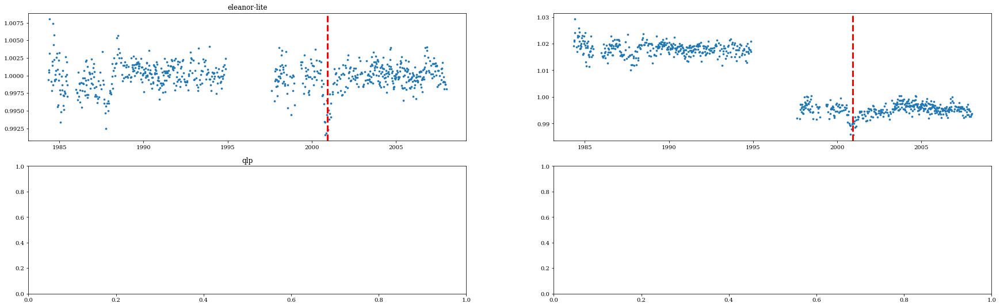

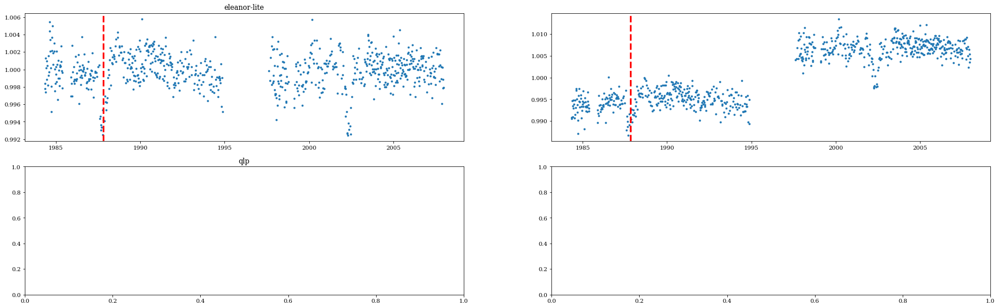

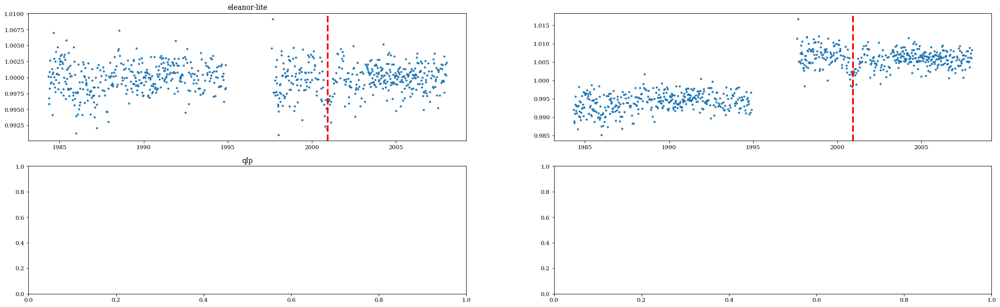

In [45]:
for i in data[data['class'] == 'red'].abs_path: #4 x 4 grid for illustration purposes
    #print(len(data_new[(data_new.asym_score >=0.9) & (data_new.asym_score <= 1) & (abs(data_new.depth) >= 0.1)]))
    lc, lc_info = import_lightcurve(i)
    lc = lc['TIME','PCA_FLUX','QUALITY','FLUX_ERR','FLUX_BKG','X_CENTROID','Y_CENTROID','CORR_FLUX','RAW_FLUX']
    fig, ax = plt.subplots(2,2,figsize=(30,9))
    ax[0,0].scatter(lc['TIME'],lc['PCA_FLUX']/np.median(lc['PCA_FLUX']),s=7)
    ax[0,0].axvline(data[data.TIC_ID == lc_info[0]].time.values[0],linestyle='--',linewidth=3,color='red')
    ax[0,1].scatter(lc['TIME'],lc['RAW_FLUX']/np.median(lc['PCA_FLUX']),s=7)
    ax[0,1].axvline(data[data.TIC_ID == lc_info[0]].time.values[0],linestyle='--',linewidth=3,color='red')
    ax[0,0].set_title('eleanor-lite')
    ax[1,0].set_title('qlp')

    #         qlp = lightcurves_dict[lc_info[0]]
    #
    try:
        qlp = lightcurves_dict[lc_info[0]]
        ax[1,0].scatter(qlp['time'].value,qlp['kspsap_flux']/np.median(qlp['kspsap_flux']),s=7)
        ax[1,0].axvline(data[data.TIC_ID == lc_info[0]].time.values[0],linestyle='--',linewidth=3,color='red',alpha=0.1)
        ax[1,1].scatter(qlp['time'].value,qlp['flux']/np.nanmedian(qlp['flux']))
        ax[1,1].axvline(data[data.TIC_ID == lc_info[0]].time.values[0],linestyle='--',linewidth=3,color='red',alpha=0.1)

    except:
        continue
    #         #_, _ = processing(lc,lc_info=lc_info,method='median',make_plots=True)
    #         fig.suptitle(f"{lc_info[0]}")
    plt.show()

In [71]:
lightcurves_dict.keys()

dict_keys([46165046, 349196570, 150727675, 44204680, 351627364, 44615937, 46274964, 349304357, 43284456, 351627251, 150731600, 349966800, 1358346986])

#### Transit Depth vs Tmag

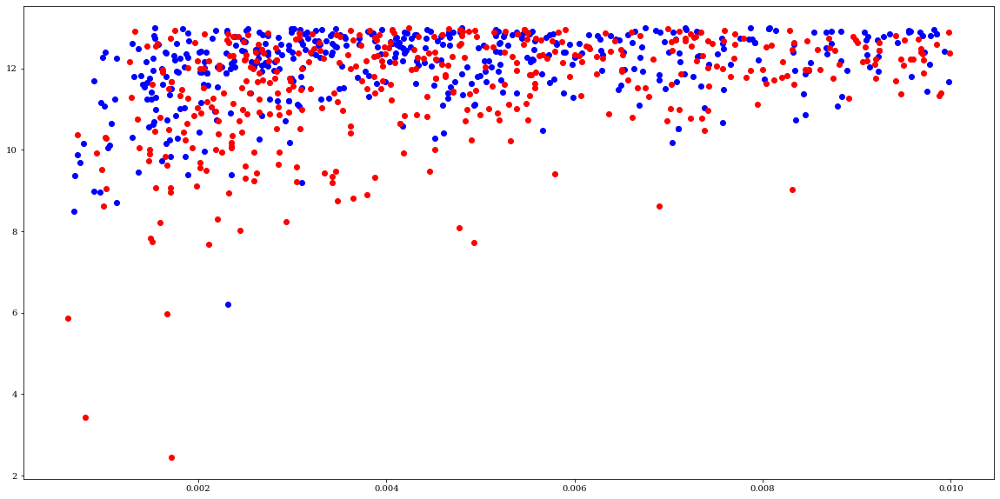

In [28]:
plt.scatter(dwarf.abs_depth,dwarf.Tmag,c='blue')
plt.scatter(giant.abs_depth,giant.Tmag,c='red')

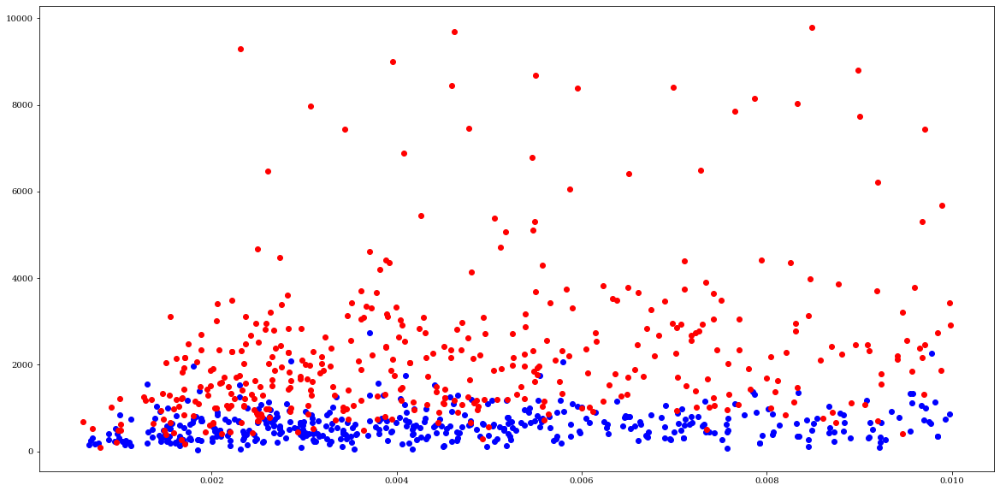

In [29]:
plt.scatter(dwarf.abs_depth,dwarf.d,c='blue')
plt.scatter(giant.abs_depth,giant.d,c='red')

In [30]:
dwarf.d

127     183.310
138     518.697
156     598.632
256     553.197
262     263.563
         ...   
3058    979.365
3076    122.370
3202    405.171
3323    654.018
3389    604.047
Name: d, Length: 65, dtype: float64

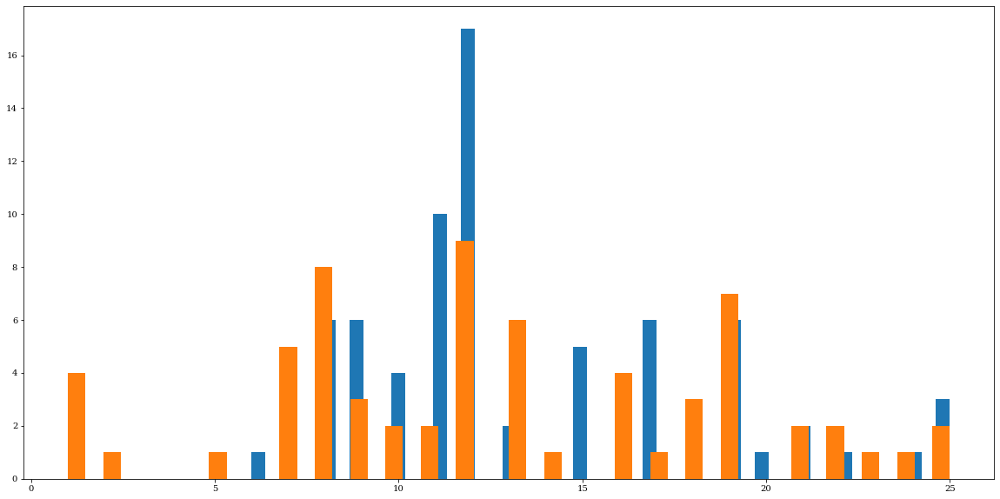

In [31]:
plt.hist(giant.Sector,bins=50)
plt.hist(dwarf.Sector,bins=50)
plt.show()

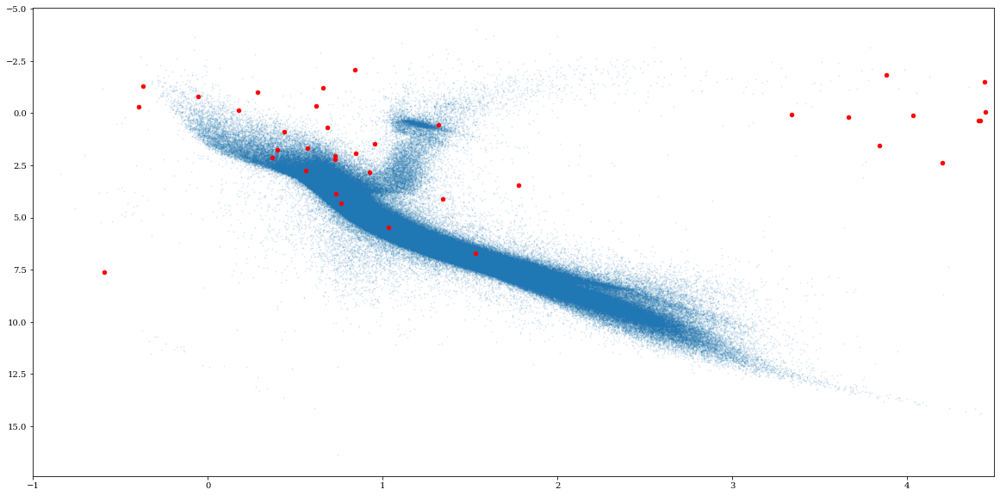

In [32]:
plt.scatter(tic[tic.d < 200]['bp-rp'],tic[tic.d < 200].M,s=1,alpha=0.1)
plt.scatter(nan['bp-rp'], nan['M'], s=20,c='red')

plt.gca().invert_yaxis()
plt.xlim([-1,4.5])
plt.show()

---

In [57]:
from post_processing import get_output

In [58]:
bigdata = get_output('../eleanor-lite-combined-v3.txt')

In [62]:
test = pd.merge(bigdata,tic,left_on='TIC_ID',right_on='tic_id',how='inner')

In [68]:
test.head()

,path,TIC_ID,signal,snr,time,asym_score,amplitude,width,skewness,skewness_err,...,Tmag,e_Tmag,Bmag,e_Bmag,Vmag,lum,lumclass,Teff,bp-rp,M
0,/tmp/eleanor-lite/s0019/hlsp_gsfc-eleanor-lite...,426145753,-9.12409,-4.65443,1826.72158,-5.0,-5.00000,-5.00000,-5.00000,-5.00000,...,12.5413,0.0101,14.599,0.045,13.593,0.092,GIANT,5168.0,1.3506,3.174974
1,/tmp/eleanor-lite/s0025/hlsp_gsfc-eleanor-lite...,426145753,-4.28984,-3.61754,1985.38307,1.0,0.00016,0.03569,0.12645,257.37364,...,12.5413,0.0101,14.599,0.045,13.593,0.092,GIANT,5168.0,1.3506,3.174974
2,/tmp/eleanor-lite/s0024/hlsp_gsfc-eleanor-lite...,426145753,-5.26662,-3.33572,1967.29990,-6.0,-6.00000,-6.00000,-6.00000,-6.00000,...,12.5413,0.0101,14.599,0.045,13.593,0.092,GIANT,5168.0,1.3506,3.174974
3,/tmp/eleanor-lite/s0018/hlsp_gsfc-eleanor-lite...,426145753,-10.27381,-9.67778,1809.13841,-3.0,-3.00000,-3.00000,-3.00000,-3.00000,...,12.5413,0.0101,14.599,0.045,13.593,0.092,GIANT,5168.0,1.3506,3.174974
4,/tmp/eleanor-lite/s0019/hlsp_gsfc-eleanor-lite...,367711603,-5.10007,-2.92912,1817.70351,-2.0,-2.00000,-2.00000,-2.00000,-2.00000,...,11.5830,0.0061,12.743,0.049,12.206,0.046,DWARF,6281.0,0.8224,3.909834


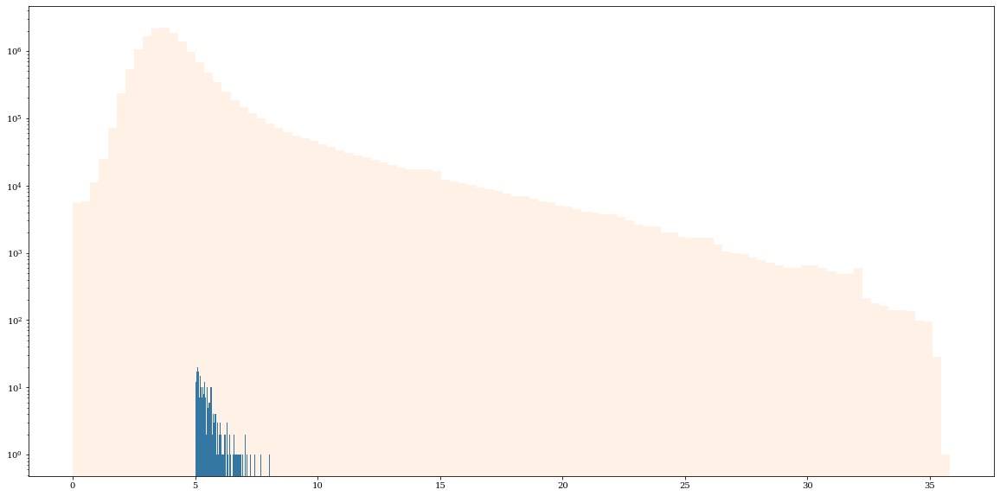

In [77]:
_, _, _ = plt.hist(abs(data.snr),bins=100)
_, _, _ = plt.hist(abs(test.snr),bins=100,alpha=0.1)
plt.yscale('log')
plt.savefig('../dist-snr-sample.png',dpi=300)

---

In [82]:
giant.head()

,path,TIC_ID,Sector,signal,snr,time,asym_score,amplitude,width,skewness,...,e_Tmag,Bmag,e_Bmag,Vmag,lum,lumclass,Teff,class,bp-rp,M
449,/tmp/eleanor-lite/s0006/hlsp_gsfc-eleanor-lite...,37485564,6,-10.02025,-5.04573,1484.84934,1.03063,0.00115,0.31849,14.64243,...,0.0191,14.957,0.061,13.616,0.092,GIANT,4880.0,red,1.5358,0.515959
542,/tmp/eleanor-lite/s0012/hlsp_gsfc-eleanor-lite...,382572476,12,-15.74046,-5.65862,1634.09473,1.03179,0.00215,0.34088,4.63601,...,0.0060,14.663,0.045,13.698,0.080,GIANT,5102.0,red,1.2213,3.151401
700,/tmp/eleanor-lite/s0007/hlsp_gsfc-eleanor-lite...,110969638,7,-16.91631,-6.24027,1513.30636,1.04608,0.00218,0.41689,6.42676,...,0.0120,16.722,0.162,14.586,0.069,GIANT,4922.0,red,2.1089,0.612743
765,/tmp/eleanor-lite/s0007/hlsp_gsfc-eleanor-lite...,350843056,7,-13.60266,-5.42235,1509.59484,1.15912,0.00144,0.42532,17.20761,...,0.0060,13.068,0.039,11.999,0.069,GIANT,5004.0,red,1.1624,0.152077
784,/tmp/eleanor-lite/s0007/hlsp_gsfc-eleanor-lite...,419365265,7,-11.77485,-5.54126,1495.74321,1.02400,0.00080,0.22296,2.33504,...,0.0084,12.461,0.300,11.791,0.021,GIANT,5471.0,red,1.3765,0.795186


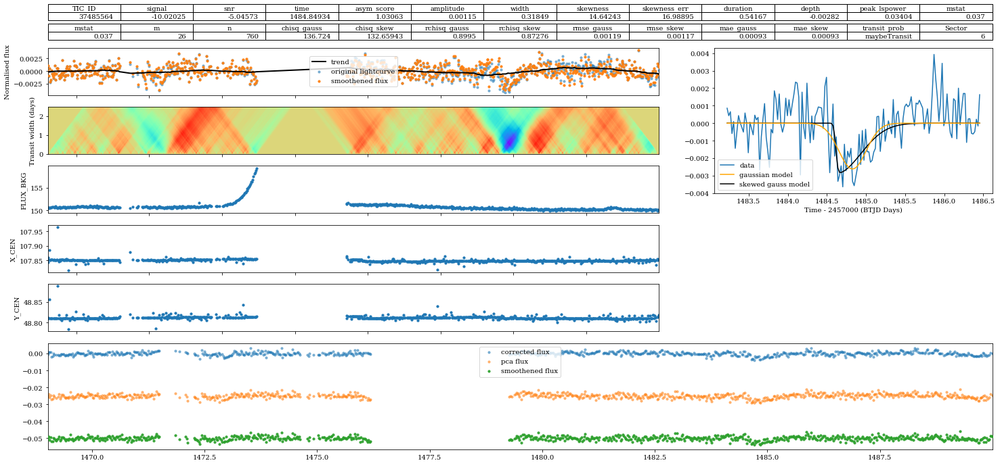

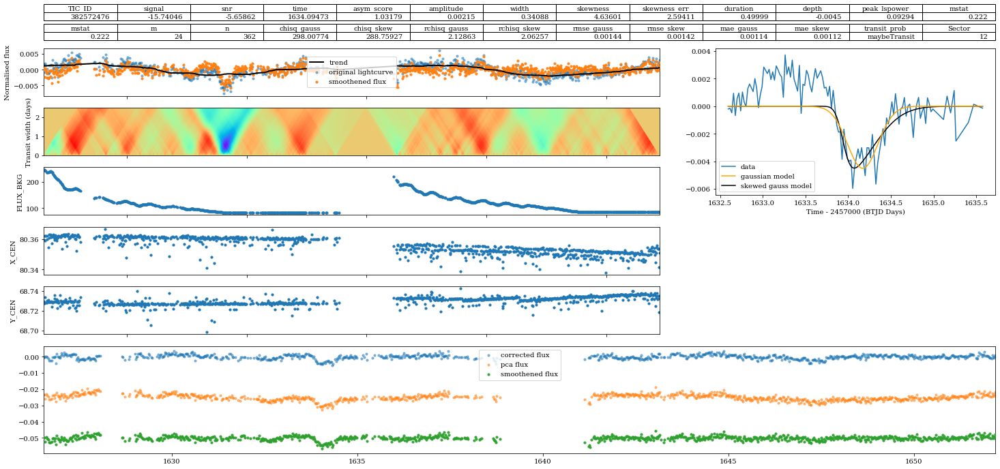

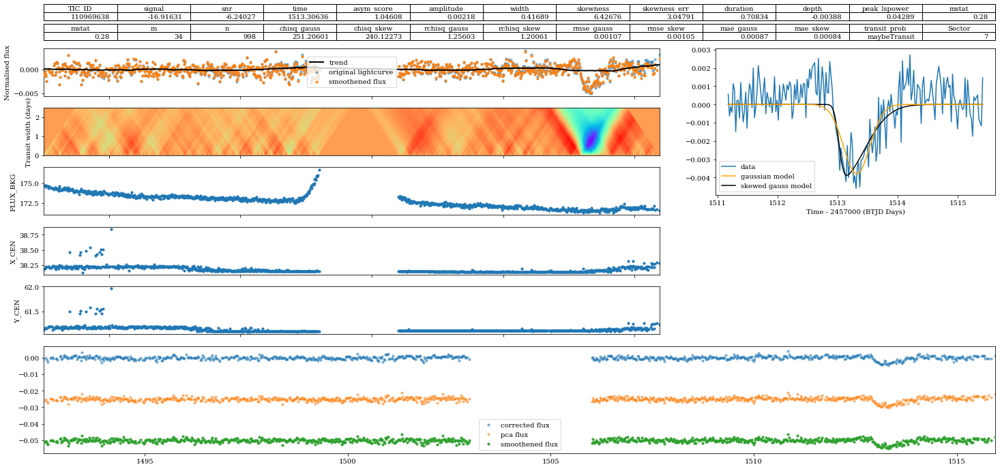

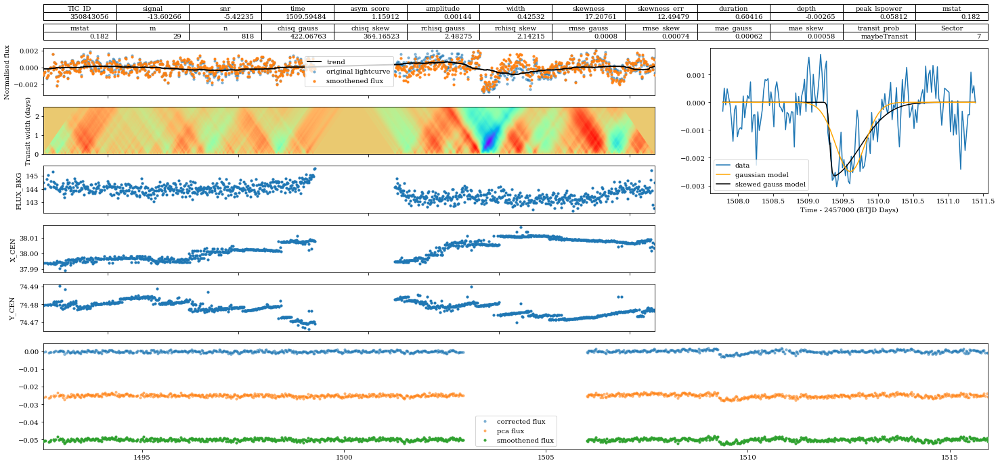

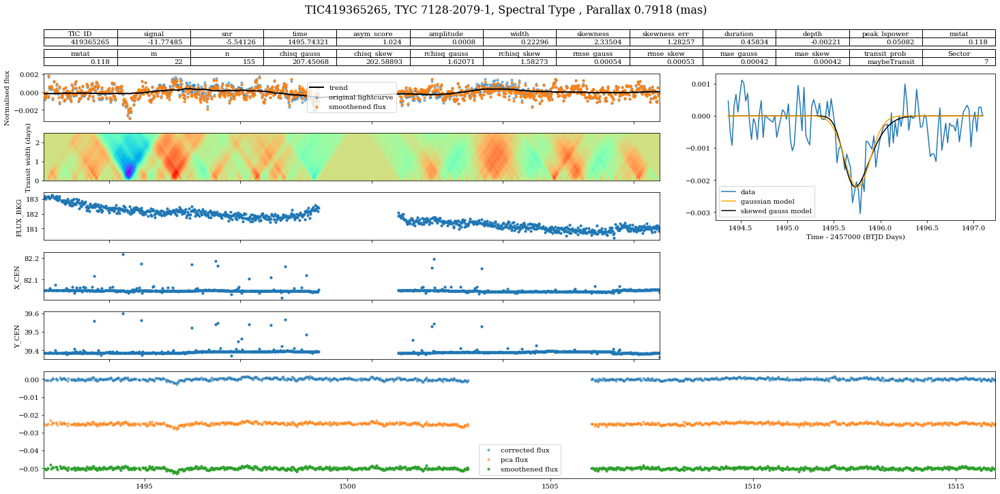

In [84]:
for i in giant.abs_path.head():
    lc, lc_info = import_lightcurve(i)
    lc = lc['TIME','PCA_FLUX','QUALITY','FLUX_ERR','FLUX_BKG','X_CENTROID','Y_CENTROID','CORR_FLUX']
    _, _ = processing(lc,lc_info=lc_info,method='median',make_plots=True)

(array([ 2.,  4.,  4., 10.,  5.,  3.,  5.,  6.,  4.,  2.,  2.,  3.,  1.,
         2.,  2.,  3.,  0.,  1.,  1.,  0.,  0.,  2.,  1.,  2.,  0.,  0.,
         1.,  1.,  0.,  0.,  2.,  0.,  0.,  0.,  1.,  1.,  1.,  0.,  1.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  1.,  0.,  0.,  1.]),
 array([ 1.7434   ,  2.0794092,  2.4154184,  2.7514276,  3.0874368,
         3.423446 ,  3.7594552,  4.0954644,  4.4314736,  4.7674828,
         5.103492 ,  5.4395012,  5.7755104,  6.1115196,  6.4475288,
         6.783538 ,  7.1195472,  7.4555564,  7.7915656,  8.1275748,
         8.463584 ,  8.7995932,  9.1356024,  9.4716116,  9.8076208,
        10.14363  , 10.4796392, 10.8156484, 11.1516576, 11.4876668,
        11.823676 , 12.1596852, 12.4956944, 12.8317036, 13.1677128,
        13.503722 , 13.8397312, 14.1757404, 14.5117496, 14.8477588,
        15.183768 , 15.5197772, 15.8557864, 16.1917956, 16.5278048,
        16.863814 , 17.1998232, 17.5358324, 17.8718416, 18.2078508,
        18.54386  ]),
 <a list of 50

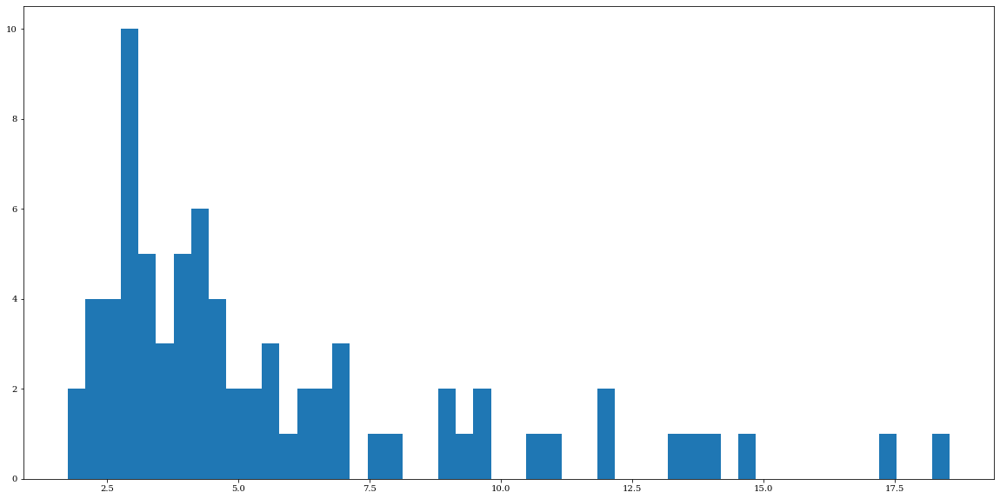

In [91]:
plt.hist(giant.skewness,bins=50)

In [92]:
nan

,path,TIC_ID,Sector,signal,snr,time,asym_score,amplitude,width,skewness,...,e_Tmag,Bmag,e_Bmag,Vmag,lum,lumclass,Teff,class,bp-rp,M
284,/tmp/eleanor-lite/s0002/hlsp_gsfc-eleanor-lite...,231792048,2,-11.59821,-5.09314,1373.94895,1.02364,0.00198,0.24385,2.86820,...,0.6000,NaN,NaN,14.3230,0.3090,NaN,NaN,orange,-0.05830,-0.809261
312,/tmp/eleanor-lite/s0004/hlsp_gsfc-eleanor-lite...,685593523,4,-12.49226,-5.30863,1432.47148,1.06548,0.00063,0.22662,15.42812,...,0.0060,NaN,NaN,11.6913,0.0471,NaN,NaN,orange,0.73460,3.857424
323,/tmp/eleanor-lite/s0004/hlsp_gsfc-eleanor-lite...,685593524,4,-12.49226,-5.30863,1432.47148,1.06548,0.00063,0.22662,15.42811,...,0.0255,NaN,NaN,12.2637,0.0702,NaN,NaN,orange,0.76360,4.302410
360,/tmp/eleanor-lite/s0005/hlsp_gsfc-eleanor-lite...,404850439,5,-19.53831,-5.55066,1456.53154,1.05062,0.00395,0.29856,1.96015,...,0.0061,NaN,NaN,13.1730,0.0570,NaN,NaN,orange,1.31840,0.574988
462,/tmp/eleanor-lite/s0006/hlsp_gsfc-eleanor-lite...,373914067,6,-16.72108,-6.64109,1482.59412,1.03147,0.00197,0.16671,3.22710,...,0.6000,NaN,NaN,13.9870,0.1270,NaN,NaN,red,-0.39740,-0.296656
572,/tmp/eleanor-lite/s0007/hlsp_gsfc-eleanor-lite...,80551703,7,-13.76701,-6.76481,1498.95247,1.05301,0.00296,0.50425,5.63506,...,0.0190,13.860,0.066,13.1470,0.0460,NaN,NaN,red,NaN,NaN
664,/tmp/eleanor-lite/s0007/hlsp_gsfc-eleanor-lite...,373913825,7,-10.59530,-5.32979,1513.76065,1.02693,0.00388,0.36511,2.73939,...,0.6000,13.672,0.066,13.8950,0.1610,NaN,NaN,red,-0.37010,-1.301339
742,/tmp/eleanor-lite/s0007/hlsp_gsfc-eleanor-lite...,64953602,7,-12.64195,-5.84385,1512.47288,1.04898,0.00227,0.19685,3.83314,...,0.0079,13.828,0.031,13.3070,0.0690,NaN,6336.0,red,0.72670,2.227108
961,/tmp/eleanor-lite/s0008/hlsp_gsfc-eleanor-lite...,842000364,8,-12.54008,-5.66159,1521.49547,1.06235,0.00223,0.36759,6.44565,...,0.0061,NaN,NaN,12.8728,0.0459,NaN,NaN,orange,1.52940,6.695384
1050,/tmp/eleanor-lite/s0008/hlsp_gsfc-eleanor-lite...,130792292,8,-13.37409,-5.65584,1520.82629,1.02914,0.00241,0.36505,5.08394,...,0.0200,14.262,0.028,13.4950,0.1260,NaN,NaN,red,NaN,NaN


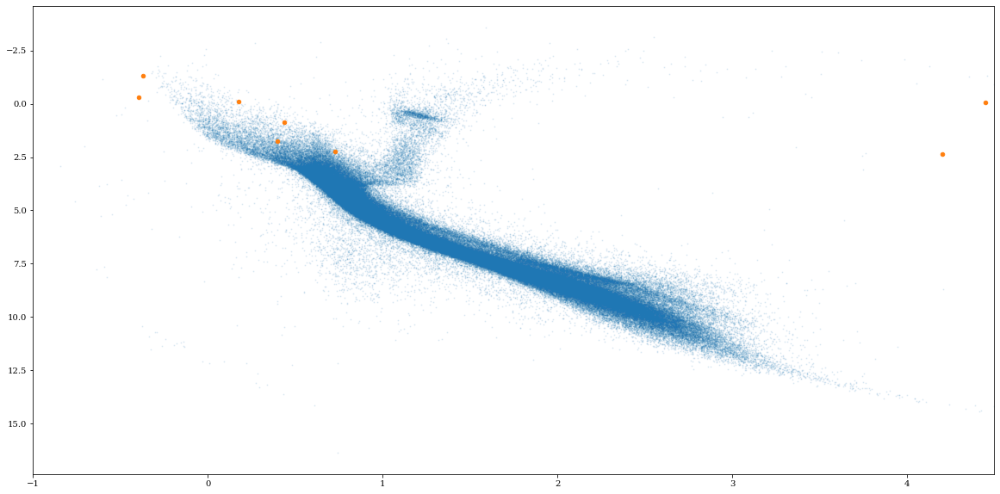

In [93]:
plt.scatter(tic[tic.d < 150]['bp-rp'],tic[tic.d < 150].M,s=1,alpha=0.1)
plt.scatter(nan[(nan['class'] == 'red')]['bp-rp'], nan[(nan['class'] == 'red')]['M'], s=20)
plt.gca().invert_yaxis()
plt.xlim([-1,4.5])
plt.show()

Bp-Rp: 1989    4.2043
Name: bp-rp, dtype: float64


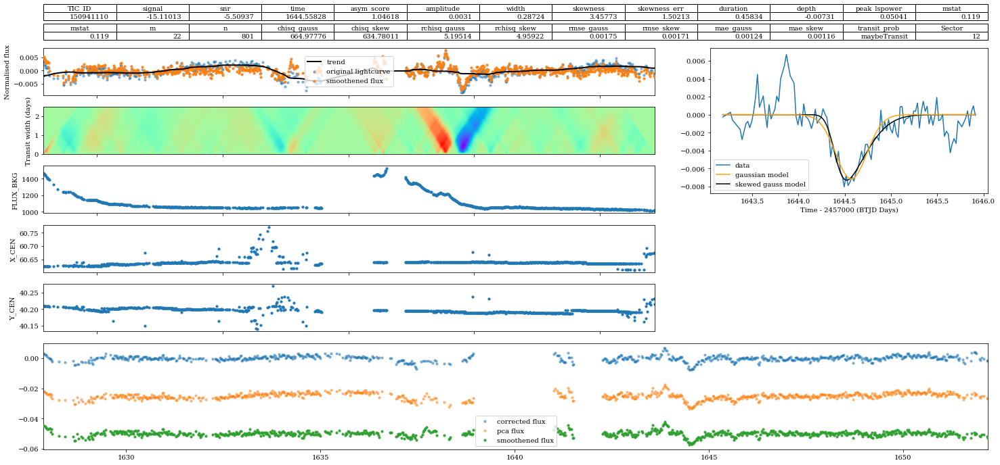

Bp-Rp: 2063    4.4494
Name: bp-rp, dtype: float64


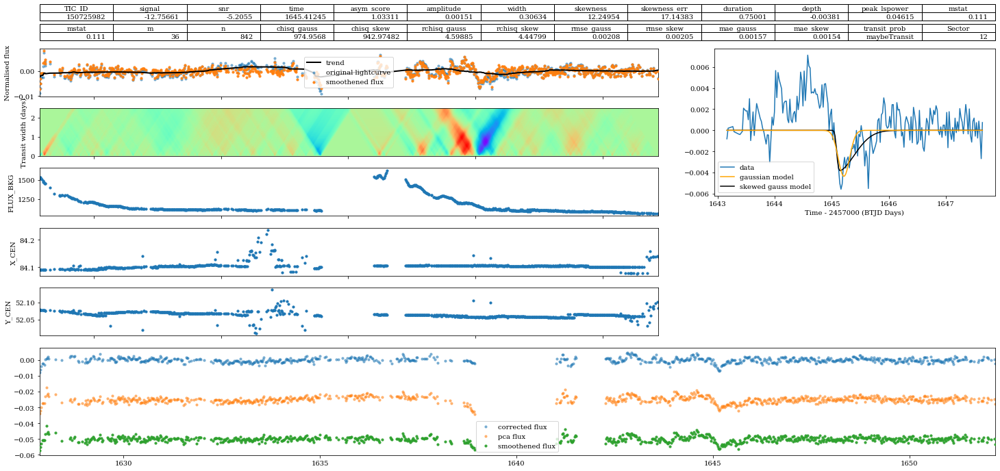

In [99]:
for i in nan[(nan['class'] == 'red') & (nan['bp-rp'] > 2)].abs_path.head():
    lc, lc_info = import_lightcurve(i)
    lc = lc['TIME','PCA_FLUX','QUALITY','FLUX_ERR','FLUX_BKG','X_CENTROID','Y_CENTROID','CORR_FLUX']
    print(f"Bp-Rp: {nan[nan.TIC_ID == lc_info[0]]['bp-rp']}")

    _, _ = processing(lc,lc_info=lc_info,method='median',make_plots=True)